In [ ]:
!pip install ydata-profiling

In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns 
from ydata_profiling import ProfileReport

In [ ]:
!gdown 15sP43Wh0AyHncJTMcFiaxe9kkkS0gw9F
!gdown 1dYCHl8qTODCm5mIpIg_8jUAFxPsZeiFG
!gdown 1LJ-DKtdWWH6wCYQXu2vtCZnHGWEIJv0D
!gdown 1EhnME2N39ICaN9v7v8PQHtPtfj0QTLk6

Downloading...
From: https://drive.google.com/uc?id=15sP43Wh0AyHncJTMcFiaxe9kkkS0gw9F
To: /content/BDIPMamaV11-INTELIDemograficosTt_DATA_LABELS_2023-01-24_1922.csv
100% 1.12M/1.12M [00:00<00:00, 110MB/s]
Downloading...
From: https://drive.google.com/uc?id=1dYCHl8qTODCm5mIpIg_8jUAFxPsZeiFG
To: /content/BDIPMamaV11-INTELIHistopatologia_DATA_LABELS_2023-01-24_1924.csv
100% 721k/721k [00:00<00:00, 76.2MB/s]
Downloading...
From: https://drive.google.com/uc?id=1LJ-DKtdWWH6wCYQXu2vtCZnHGWEIJv0D
To: /content/BDIPMamaV11-INTELIPesoEAltura_DATA_LABELS_2023-01-24_1926.csv
100% 2.93M/2.93M [00:00<00:00, 200MB/s]
Downloading...
From: https://drive.google.com/uc?id=1EhnME2N39ICaN9v7v8PQHtPtfj0QTLk6
To: /content/BDIPMamaV11-INTELIRegistroDeTumo_DATA_LABELS_2023-01-24_1924.csv
100% 1.39M/1.39M [00:00<00:00, 62.1MB/s]


#1-Importing CSV

In [ ]:
dfd = pd.read_csv('/content/BDIPMamaV11-INTELIDemograficosTt_DATA_LABELS_2023-01-24_1922.csv')
dfh = pd.read_csv('/content/BDIPMamaV11-INTELIHistopatologia_DATA_LABELS_2023-01-24_1924.csv')
dfpa = pd.read_csv('/content/BDIPMamaV11-INTELIPesoEAltura_DATA_LABELS_2023-01-24_1926.csv')
dfrt = pd.read_csv('/content/BDIPMamaV11-INTELIRegistroDeTumo_DATA_LABELS_2023-01-24_1924.csv')

#2-Limpeza e Tratamento de dados

##2.1-DF Peso e Altura

###2.1.1-Overview

In [ ]:
dfpa_profiling = ProfileReport(dfpa, title="DFPA Profiling Report")

In [ ]:
dfpa_profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###2.1.2-Tratamento

Bem, primeiramente é importante entendermos o motivo de fazer a limpeza dos dados previamente. Nesse sentido, fazer a limpeza inicial dos dados é importante antes de começar a explorá-los e tratá-los porque os dados brutos geralmente contêm valores faltantes, valores inválidos, duplicatas, inconsistências, entre outros problemas que podem afetar negativamente as análises subsequentes. Se esses problemas não forem tratados antes de prosseguir com a análise, eles podem resultar em conclusões imprecisas ou enganosas.

In [ ]:
#Renomeando as colunas
dfpa = dfpa.rename(columns = {'Data: ':'Data', 'Altura (em centimetros)':'Altura', 
                       'Repeat Instance':'Repeat_Instance', 'Record ID':'record_id', 'Repeat Instrument':'Repeat_Instrument'})
#Retirando a coluna Repeat_Instrument
dfpa = dfpa.drop("Repeat_Instrument", axis='columns')
#Tabela reserva para teste
dfpaTEST = dfpa

#Retirando todas as que possuem todas colunas nulas
dfpa = dfpa.dropna(thresh = 2)
dfpa

,record_id,Repeat_Instance,Data,Peso,Altura,IMC
1,302,1.0,2009-03-06,58.00,NaN,inf
2,302,2.0,2009-01-23,57.00,158.0,22.8
3,302,3.0,2009-02-06,57.00,158.0,22.8
4,302,4.0,2009-12-25,62.00,158.0,24.8
5,302,5.0,2011-07-09,57.75,158.0,23.1
...,...,...,...,...,...,...
55648,82205,3.0,2021-06-09,140.00,172.0,47.3
55649,82205,4.0,2021-02-28,135.85,174.0,44.9
55650,82205,5.0,2021-07-12,124.10,174.0,41.0
55652,82240,1.0,2020-12-08,80.35,161.0,31.0


In [ ]:
dfpa.reset_index()
#Criando uma lista que irá receber todos os valores novos da altura
new_altura = []
#tratando os nan
def missing_altura(data):
  mode_mean = data['Altura'].mode(dropna=True).mean()
  data['Altura'] = data['Altura'].replace(np.nan, mode_mean)

#padronizando a altura de cada paciente
def standardize_altura(data):
  mode_mean = data['Altura'].mode(dropna=True).mean()

  for i in data['Altura']:
    if i < mode_mean or i > mode_mean:
      data['Altura'] = data['Altura'].replace(i, mode_mean)
    new_altura.append(i)

#função que irá ser chamada pelo apply
def treatment_altura(data):
  missing_altura(data)
  standardize_altura(data)

#agrupando em subconjuntos pelo Record_Id, tratando os dados levando em consideração um paciente
dfpa_groupby = dfpa.groupby(['record_id']).apply(treatment_altura)

In [ ]:
#Tratando os elementos restantes
dfpa['New_Altura'] = new_altura
dfpa['New_Altura'] = dfpa['New_Altura'].replace(np.nan, dfpa['New_Altura'].mode(dropna=True).mean())
dfpa['New_Altura'] = dfpa['New_Altura'].replace(0, dfpa['New_Altura'].mode(dropna=True).mean())
dfpa['New_Altura'] = dfpa['New_Altura'].replace(78, dfpa['New_Altura'].mode(dropna=True).mean())
dfpa = dfpa.drop(columns='Altura')
dfpa = dfpa.rename(columns = {'New_Altura':'Altura'})
dfpa.head()

<ipython-input-11-ae2c2f2d8c97>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfpa['New_Altura'] = new_altura
<ipython-input-11-ae2c2f2d8c97>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfpa['New_Altura'] = dfpa['New_Altura'].replace(np.nan, dfpa['New_Altura'].mode(dropna=True).mean())
<ipython-input-11-ae2c2f2d8c97>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentat

,record_id,Repeat_Instance,Data,Peso,IMC,Altura
1,302,1.0,2009-03-06,58.00,inf,158.0
2,302,2.0,2009-01-23,57.00,22.8,158.0
3,302,3.0,2009-02-06,57.00,22.8,158.0
4,302,4.0,2009-12-25,62.00,24.8,158.0
5,302,5.0,2011-07-09,57.75,23.1,158.0


In [ ]:
#tratando os pesos a partir do agrupamento dos pacientes pelo seu Record_ID
def missing_peso(data):
  if len(data) == 1:
    return data

  else:
    data['Peso'] = data['Peso'].replace(np.nan, data['Peso'].median())
    for i in data['Peso']:
      if i >= data['Peso'].mean()+data['Peso'].std()*3 or i < data['Peso'].mean()-data['Peso'].std()*3:
        data['Peso'] = data['Peso'].replace(i, data['Peso'].mean())
    return data


dfpa = dfpa.groupby(['record_id']).apply(missing_peso)
dfpa['Peso'] = dfpa['Peso'].replace(np.nan, dfpa['Peso'].mode().mean())
dfpa['Peso'] = dfpa['Peso'].replace(1, dfpa['Peso'].mode().mean())

/usr/local/lib/python3.9/dist-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.9/dist-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.9/dist-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.9/dist-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.9/dist-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.9/dist-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/p

In [ ]:
#Recalculando o IMC com os novos dados
def imc(row):
  row['IMC'] = (row['Peso']/(row['Altura']**2))*10000
  return row
dfpa = dfpa.apply(imc, axis = 1)
dfpa

,record_id,Repeat_Instance,Data,Peso,IMC,Altura
1,302,1.0,2009-03-06,58.00,23.233456,158.0
2,302,2.0,2009-01-23,57.00,22.832879,158.0
3,302,3.0,2009-02-06,57.00,22.832879,158.0
4,302,4.0,2009-12-25,62.00,24.835763,158.0
5,302,5.0,2011-07-09,57.75,23.133312,158.0
...,...,...,...,...,...,...
55648,82205,3.0,2021-06-09,140.00,47.322877,172.0
55649,82205,4.0,2021-02-28,135.85,44.870525,174.0
55650,82205,5.0,2021-07-12,124.10,40.989563,174.0
55652,82240,1.0,2020-12-08,80.35,30.998032,161.0


In [ ]:
#Ordena a partir da data e retorna o resultado da primeira consulta
def agrupamento(data):
  data = data.sort_values(by='Data', ascending = True)
  return data.iloc[0]

dfpa = dfpa.groupby(by='record_id', as_index = False).apply(agrupamento)
dfpa

,record_id,Repeat_Instance,Data,Peso,IMC,Altura
0,302,20.0,2009-01-02,57.80,23.153341,158.0
1,710,18.0,2008-07-12,61.00,25.065746,156.0
2,752,2.0,2009-12-03,84.00,36.357341,152.0
3,1367,1.0,2010-04-28,57.90,28.314343,143.0
4,1589,12.0,2009-04-03,63.20,22.661264,167.0
...,...,...,...,...,...,...
3798,82123,5.0,2021-02-07,85.40,36.481695,153.0
3799,82124,1.0,2020-11-10,81.10,35.568615,151.0
3800,82131,1.0,2020-11-01,71.40,29.152079,156.5
3801,82205,4.0,2021-02-28,135.85,44.870525,174.0


* O código abaixo seleciona as features de dfpa

In [ ]:
#dataframe para o merge
dfpa_final = dfpa.drop(columns = ['Data', 'Repeat_Instance'])

###2.1.3-Resultado

In [ ]:
dfpa_final_profiling = ProfileReport(dfpa_final, title="DFPA_FINAL Profiling Report")
dfpa_final_profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##2.2-DF Registro Tumoral

###2.2.1-Overview

In [ ]:
dfrt_profiling = ProfileReport(dfrt, title="DFRT Profiling Report")
dfrt_profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###2.2.2-Tratamento

####2.2.2.1 Renomeando as colunas

In [ ]:
# renomeando colunas 
dfrt = dfrt.rename(columns={   
                            'Record ID': 'record_id',
                            'Repeat Instrument': 'repeat_instrument',
                            'Repeat Instance': 'repeat_instance',
                            'Data da primeira consulta institucional [dt_pci]': 'data_da_primeira_consulta_institucional_dt_pci',
                            'Data do diagnóstico': 'data_do_diagnostico',
                            'Código da Topografia (CID-O)': 'codigo_da_topografia_cid_o',
                            'Código da Morfologia de acordo com o CID-O': 'codigo_da_morfologia_cid_o',
                            'Estadio Clínico  ': 'estadio_clinico',
                            'Grupo de Estadio Clínico': 'grupo_estadio_clinico',
                            'Classificação TNM Clínico - T': 'classificacao_tnm_clinico_t',
                            'Classificação TNM Clínico - N': 'classificacao_tnm_clinico_n',
                            'Classificação TNM Clínico - M': 'classificacao_tnm_clinico_m',
                            'Metastase ao DIAGNOSTICO - CID-O #1': 'metastase_diagnostico_cid_o_1',
                            'Metastase ao DIAGNOSTICO - CID-O #2': 'metastase_diagnostico_cid_o_2',
                            'Metastase ao DIAGNOSTICO - CID-O #3': 'metastase_diagnostico_cid_o_3',
                            'Metastase ao DIAGNOSTICO - CID-O #4': 'metastase_diagnostico_cid_o_4',
                            'Data do tratamento': 'data_do_tratamento',
                            'Combinação dos Tratamentos Realizados no Hospital': 'combinacao_dos_tratamentos_realizados_no_hospital',
                            'Ano do diagnostico': 'ano_do_diagnostico',
                            'Lateralidade do tumor': 'lateralidade_do_tumor',
                            'Data de Recidiva': 'data_recidiva',
                            'Tempo desde o diagnóstico até a primeira recidiva  ': 'tempo_desde_o_diagnostico_ate_primeira_recidiva_',
                            'Local de Recidiva a  distancia/ metastase #1 - CID-O - Topografia': 'local_recidiva_a _distancia_metastase_1_cid_o_topografia',
                            'Local de Recidiva a  distancia/ metastase #2 - CID-O - Topografia': 'local_recidiva_a _distancia_metastase_2_cid_o_topografia',
                            'Local de Recidiva a  distancia/ metastase #3 - CID-O - Topografia': 'local_recidiva_a _distancia_metastase_3_cid_o_topografia',
                            'Local de Recidiva a  distancia/ metastase #4 - CID-O - Topografia': 'local_recidiva_a _distancia_metastase_4_cid_o_topografia',
                            'Descrição da Morfologia de acordo com o CID-O  (CID-O - 3ª edição)': 'descricao_da_morfologia_acordo_com_o_cid_o_cid_o_3_edicao',
                            'Descrição da Topografia ': 'descricao_da_topografia_',
                            'Classificação TNM Patológico - N': 'classificacao_tnm_patologico_n',
                            'Classificação TNM Patológico - T': 'classificacao_tnm_patologico_t',
                            'Com recidiva à distância': 'com_recidiva_distancia',
                            'Com recidiva regional': 'com_recidiva_regional',
                            'Com recidiva local': 'com_recidiva_local'
                            })


dfrt.columns 

Index(['record_id', 'repeat_instrument', 'repeat_instance',
       'data_da_primeira_consulta_institucional_dt_pci', 'data_do_diagnostico',
       'codigo_da_topografia_cid_o', 'codigo_da_morfologia_cid_o',
       'estadio_clinico', 'grupo_estadio_clinico',
       'classificacao_tnm_clinico_t', 'classificacao_tnm_clinico_n',
       'classificacao_tnm_clinico_m', 'metastase_diagnostico_cid_o_1',
       'metastase_diagnostico_cid_o_2', 'metastase_diagnostico_cid_o_3',
       'metastase_diagnostico_cid_o_4', 'data_do_tratamento',
       'combinacao_dos_tratamentos_realizados_no_hospital',
       'Ano do diagnóstico', 'lateralidade_do_tumor', 'data_recidiva',
       'tempo_desde_o_diagnostico_ate_primeira_recidiva_',
       'local_recidiva_a _distancia_metastase_1_cid_o_topografia',
       'local_recidiva_a _distancia_metastase_2_cid_o_topografia',
       'local_recidiva_a _distancia_metastase_3_cid_o_topografia',
       'local_recidiva_a _distancia_metastase_4_cid_o_topografia',
       'd

####2.2.2.2 Retirando linhas nulas

In [ ]:
(dfrt.isnull().mean())*100

record_id                                                     0.000000
repeat_instrument                                            47.737177
repeat_instance                                              47.737177
data_da_primeira_consulta_institucional_dt_pci               47.737177
data_do_diagnostico                                          47.737177
codigo_da_topografia_cid_o                                   47.737177
codigo_da_morfologia_cid_o                                   47.737177
estadio_clinico                                              47.737177
grupo_estadio_clinico                                        50.664879
classificacao_tnm_clinico_t                                  47.737177
classificacao_tnm_clinico_n                                  47.737177
classificacao_tnm_clinico_m                                  47.737177
metastase_diagnostico_cid_o_1                                92.032629
metastase_diagnostico_cid_o_2                                95.653146
metast

Limpeza: Bem, primeiramente é importante entendermos o motivo de fazer a limpeza dos dados previamente. Nesse sentido, fazer a limpeza inicial dos dados é importante antes de começar a explorá-los e tratá-los porque os dados brutos geralmente contêm valores faltantes, valores inválidos, duplicatas, inconsistências, entre outros problemas que podem afetar negativamente as análises subsequentes. Se esses problemas não forem tratados antes de prosseguir com a análise, eles podem resultar em conclusões imprecisas ou enganosas.

In [ ]:
dfrt.shape

(8949, 33)

In [ ]:
# tirando todas as linhas nulas
dfrt= dfrt.dropna(thresh = 2, how = 'all')
dfrt

,record_id,repeat_instrument,repeat_instance,data_da_primeira_consulta_institucional_dt_pci,data_do_diagnostico,codigo_da_topografia_cid_o,codigo_da_morfologia_cid_o,estadio_clinico,grupo_estadio_clinico,classificacao_tnm_clinico_t,...,local_recidiva_a _distancia_metastase_2_cid_o_topografia,local_recidiva_a _distancia_metastase_3_cid_o_topografia,local_recidiva_a _distancia_metastase_4_cid_o_topografia,descricao_da_morfologia_acordo_com_o_cid_o_cid_o_3_edicao,descricao_da_topografia_,classificacao_tnm_patologico_n,classificacao_tnm_patologico_t,com_recidiva_distancia,com_recidiva_regional,com_recidiva_local
1,302,Registro De Tumores,1.0,2008-03-22,2008-03-23,C504,85003.0,IIA,II,2,...,NaN,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE SUPERIOR EXTERNO DA,NaN,NaN,Não,Não,Não
3,710,Registro De Tumores,1.0,2006-11-11,2007-11-11,C508,85003.0,IIIA,III,3,...,NaN,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA LESAO SOBREPOSTA DA,NaN,NaN,Não,Sim,Sim
5,752,Registro De Tumores,1.0,2007-09-25,2007-12-18,C509,84803.0,IIA,II,2,...,NaN,NaN,NaN,ADENOCARCINOMA MUCINOSO,MAMA SOE (EXCLUI PELE DA MAMA C44.5),X - nao foi possivel determinar,2,Não,Não,Não
7,1367,Registro De Tumores,1.0,2008-02-03,2008-02-06,C505,85003.0,IIA,II,1,...,C50 - Mama,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE INFERIOR EXTERNO DA,1,1A,Não,Sim,Não
9,1589,Registro De Tumores,1.0,2008-05-15,2008-05-21,C508,85003.0,IIB,II,2,...,NaN,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA LESAO SOBREPOSTA DA,NaN,NaN,Não,Não,Não
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8941,82124,Registro De Tumores,1.0,2020-06-20,2020-09-05,C509,85203.0,IV,NaN,4D,...,NaN,NaN,NaN,CARCINOMA LOBULAR SOE,MAMA SOE (EXCLUI PELE DA MAMA C44.5),NaN,NaN,Não,Não,Não
8942,82124,Registro De Tumores,2.0,2020-06-20,2020-09-05,C509,85002.0,0,NaN,CDIS,...,NaN,NaN,NaN,CARCINOMA INTRADUCTAL NAO INFILTRANTE SOE,MAMA SOE (EXCLUI PELE DA MAMA C44.5),NaN,NaN,Não,Não,Não
8944,82131,Registro De Tumores,1.0,2020-11-01,2019-12-23,C502,85203.0,IIIA,NaN,3,...,NaN,NaN,NaN,CARCINOMA LOBULAR SOE,MAMA QUADRANTE SUPERIOR INTERNO DA,NaN,NaN,Não,Não,Não
8946,82205,Registro De Tumores,1.0,2021-02-28,2020-11-07,C504,85003.0,IV,NaN,4D,...,NaN,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE SUPERIOR EXTERNO DA,NaN,NaN,Não,Não,Sim


In [ ]:
# identificando redução de 47% das linhas 
dfrt.shape

(4677, 33)

In [ ]:
dfrt.head()

,record_id,repeat_instrument,repeat_instance,data_da_primeira_consulta_institucional_dt_pci,data_do_diagnostico,codigo_da_topografia_cid_o,codigo_da_morfologia_cid_o,estadio_clinico,grupo_estadio_clinico,classificacao_tnm_clinico_t,...,local_recidiva_a _distancia_metastase_2_cid_o_topografia,local_recidiva_a _distancia_metastase_3_cid_o_topografia,local_recidiva_a _distancia_metastase_4_cid_o_topografia,descricao_da_morfologia_acordo_com_o_cid_o_cid_o_3_edicao,descricao_da_topografia_,classificacao_tnm_patologico_n,classificacao_tnm_patologico_t,com_recidiva_distancia,com_recidiva_regional,com_recidiva_local
1,302,Registro De Tumores,1.0,2008-03-22,2008-03-23,C504,85003.0,IIA,II,2,...,NaN,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE SUPERIOR EXTERNO DA,NaN,NaN,Não,Não,Não
3,710,Registro De Tumores,1.0,2006-11-11,2007-11-11,C508,85003.0,IIIA,III,3,...,NaN,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA LESAO SOBREPOSTA DA,NaN,NaN,Não,Sim,Sim
5,752,Registro De Tumores,1.0,2007-09-25,2007-12-18,C509,84803.0,IIA,II,2,...,NaN,NaN,NaN,ADENOCARCINOMA MUCINOSO,MAMA SOE (EXCLUI PELE DA MAMA C44.5),X - nao foi possivel determinar,2,Não,Não,Não
7,1367,Registro De Tumores,1.0,2008-02-03,2008-02-06,C505,85003.0,IIA,II,1,...,C50 - Mama,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE INFERIOR EXTERNO DA,1,1A,Não,Sim,Não
9,1589,Registro De Tumores,1.0,2008-05-15,2008-05-21,C508,85003.0,IIB,II,2,...,NaN,NaN,NaN,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA LESAO SOBREPOSTA DA,NaN,NaN,Não,Não,Não


In [ ]:
#pega apenas a primeira vez que o paciente apareceu em relação a data
teste = []
def pega_o_primeiro(data):
  data['data_da_primeira_consulta_institucional_dt_pci'].sort_values()
  teste.append(data.iloc[0])

dfrt.groupby(by = 'record_id').apply(pega_o_primeiro)
dfrt = pd.DataFrame(teste, columns=dfrt.columns)

####2.2.2.3 Filtrando apenas os dados de cancer de mama

In [ ]:
#analizando todos os tipos de câncer na tabela
dfrt['descricao_da_topografia_'].unique()

array(['MAMA QUADRANTE SUPERIOR EXTERNO DA', 'MAMA LESAO SOBREPOSTA DA',
       'MAMA SOE (EXCLUI PELE DA MAMA C44.5)',
       'MAMA QUADRANTE INFERIOR EXTERNO DA', 'MAMA PORCAO CENTRAL DA',
       'MAMA QUADRANTE SUPERIOR INTERNO DA', 'MAMA MAMILO',
       'MAMA QUADRANTE INFERIOR INTERNO DA', 'ASSOALHO DA BOCA SOE',
       'MAMA PORCAO AXILAR DA', 'CECO', 'RETO SOE', 'COLO DO UTERO'],
      dtype=object)

In [ ]:
#filtrando apenas os cânceres possíveis de mama
dfrt = dfrt[dfrt['descricao_da_topografia_'].str.contains("MAMA")]
dfrt['descricao_da_topografia_'].unique()

array(['MAMA QUADRANTE SUPERIOR EXTERNO DA', 'MAMA LESAO SOBREPOSTA DA',
       'MAMA SOE (EXCLUI PELE DA MAMA C44.5)',
       'MAMA QUADRANTE INFERIOR EXTERNO DA', 'MAMA PORCAO CENTRAL DA',
       'MAMA QUADRANTE SUPERIOR INTERNO DA', 'MAMA MAMILO',
       'MAMA QUADRANTE INFERIOR INTERNO DA', 'MAMA PORCAO AXILAR DA'],
      dtype=object)

####2.2.2.4 Retirando Repeat_instrument

In [ ]:
dfrt = dfrt.reset_index()

In [ ]:
# Como os valores de Repeat_instrument são sempre os mesmos, eles não irão ajudar na análise
# Logo, essa coluna será retirada
dfrt = dfrt.drop(["repeat_instrument"], axis=1)


####2.2.2.5 TRATANDO MISSINGS 

In [ ]:
#algumas colunas estão relacionadas com a determinação do dado a partir de exames clínicos ou laboratoriais
#logo, para essas colunas, os missings serão nomeados X - nao foi possivel determinar'
x_nao_possivel_determinar = ['estadio_clinico', 'grupo_estadio_clinico', 'classificacao_tnm_clinico_t', 'classificacao_tnm_clinico_n', 'classificacao_tnm_clinico_m', 'classificacao_tnm_patologico_n', 'classificacao_tnm_patologico_t']
for coluna in x_nao_possivel_determinar:
  dfrt[coluna] = dfrt[coluna].replace('X: não foi possível determinar', 'X - nao foi possivel determinar')
  dfrt[coluna] = dfrt[coluna].replace(np.nan, 'X - nao foi possivel determinar')
  dfrt[coluna] = dfrt[coluna].replace('Y: Na', 'X - nao foi possivel determinar')
  dfrt[coluna] = dfrt[coluna].replace('Y: NA', 'X - nao foi possivel determinar')

In [ ]:
#Mudando o valor dos missings por não identificado das outras tabelas
nan = ['metastase_diagnostico_cid_o_1', 'metastase_diagnostico_cid_o_2', 'metastase_diagnostico_cid_o_3', 'metastase_diagnostico_cid_o_4', 'tempo_desde_o_diagnostico_ate_primeira_recidiva_', 'local_recidiva_a _distancia_metastase_1_cid_o_topografia', 'local_recidiva_a _distancia_metastase_2_cid_o_topografia', 'local_recidiva_a _distancia_metastase_3_cid_o_topografia', 'local_recidiva_a _distancia_metastase_4_cid_o_topografia']
for coluna in nan:
  dfrt[coluna] = dfrt[coluna].replace(np.nan, 'não identificado')
  dfrt[coluna] = dfrt[coluna].replace('Y: Na', 'não identificado')
  dfrt[coluna] = dfrt[coluna].replace('Y: NA', 'não identificado')

In [ ]:
# visualizando o corpo da tabela
for coluna in dfrt:
    print(coluna, ':\n', dfrt[coluna].value_counts(), '\n')



index :
 1       1
5932    1
5903    1
5905    1
5908    1
       ..
2999    1
3001    1
3003    1
3005    1
8948    1
Name: index, Length: 4268, dtype: int64 

record_id :
 302      1
60900    1
60736    1
60742    1
60757    1
        ..
37719    1
37723    1
37725    1
37750    1
82240    1
Name: record_id, Length: 4268, dtype: int64 

repeat_instance :
 1.0    4268
Name: repeat_instance, dtype: int64 

data_da_primeira_consulta_institucional_dt_pci :
 2011-08-14    8
2017-05-12    7
2018-01-02    6
2016-09-01    6
2016-06-09    6
             ..
2013-02-22    1
2013-08-31    1
2013-07-17    1
2013-08-09    1
2020-12-08    1
Name: data_da_primeira_consulta_institucional_dt_pci, Length: 2463, dtype: int64 

data_do_diagnostico :
 2012-03-17    7
2016-05-27    7
2011-02-01    7
2015-08-02    7
2015-07-06    6
             ..
2013-03-10    1
2012-12-19    1
2013-06-01    1
2013-05-03    1
2020-11-07    1
Name: data_do_diagnostico, Length: 2460, dtype: int64 

codigo_da_topografia_cid_o

####2.2.2.6 Tratando o Estadio Clínico e TNM

In [ ]:
dfrt['estadio_clinico']=np.where((dfrt['classificacao_tnm_clinico_m']=='1'), 4, dfrt['estadio_clinico'])
dfrt['estadio_clinico'].value_counts()

IIA                                908
IIIA                               722
IIB                                715
4                                  545
IIIB                               460
IA                                 408
I                                  240
IIIC                               183
0                                   37
IB                                  36
X - nao foi possivel determinar     14
Name: estadio_clinico, dtype: int64

In [ ]:
dfrt['estadio_clinico']=np.where(((dfrt['classificacao_tnm_clinico_n']=='3')|(dfrt['estadio_clinico']=='IIIC')), '3c', dfrt['estadio_clinico'])
dfrt['estadio_clinico'].value_counts()

IIA                                908
IIIA                               722
IIB                                715
4                                  482
IIIB                               460
IA                                 408
3c                                 246
I                                  240
0                                   37
IB                                  36
X - nao foi possivel determinar     14
Name: estadio_clinico, dtype: int64

In [ ]:
dfrt['estadio_clinico'].unique()

array(['IIA', 'IIIA', 'IIB', 4, 'IIIB', '3c', 'I', '0',
       'X - nao foi possivel determinar', 'IA', 'IB'], dtype=object)

In [ ]:
dfrt['classificacao_tnm_clinico_n'].unique()

array(['0', '1', '2', '3', '3C', '2A', '3A', '3B',
       'X - nao foi possivel determinar', '2B'], dtype=object)

In [ ]:
dfrt['classificacao_tnm_clinico_m'].unique()

array(['0', '1', 'X - nao foi possivel determinar'], dtype=object)

In [ ]:
dfrt['classificacao_tnm_clinico_t'].unique()

array(['2', '3', '1', '1C', '4', '4B', 'IS', '1B', '4D', '4A', '1A',
       'X - nao foi possivel determinar', '0', '4C', '1MIC', 'CDIS',
       'CLIS'], dtype=object)

In [ ]:
dfrt['classificacao_tnm_clinico_t'].value_counts()

2                                  1608
3                                   852
1C                                  579
4B                                  489
4D                                  135
1B                                  133
4                                   128
1                                   126
1A                                   73
4C                                   42
X - nao foi possivel determinar      34
IS                                   27
4A                                   23
CDIS                                  9
1MIC                                  6
0                                     3
CLIS                                  1
Name: classificacao_tnm_clinico_t, dtype: int64

In [ ]:
dfrt['classificacao_tnm_clinico_t']=np.where((dfrt['classificacao_tnm_clinico_t']=='CDIS') | (dfrt['classificacao_tnm_clinico_t']=='CLIS') | (dfrt['classificacao_tnm_clinico_t']=='IS') | (dfrt['classificacao_tnm_clinico_t']=='1MIC'), '0', dfrt['classificacao_tnm_clinico_t'])

In [ ]:
dfrt['estadio_clinico']=np.where(((dfrt['classificacao_tnm_clinico_t']=='4')&(dfrt['classificacao_tnm_clinico_n']!='3')|(dfrt['estadio_clinico']=='IIIB')), '3b', dfrt['estadio_clinico'])
dfrt['estadio_clinico'].value_counts()

IIA                                908
IIIA                               722
IIB                                715
3b                                 498
4                                  445
IA                                 408
3c                                 245
I                                  240
0                                   37
IB                                  36
X - nao foi possivel determinar     14
Name: estadio_clinico, dtype: int64

In [ ]:
# dfrt['estadio_clinico']=np.where(
#     (
#         (
#             (dfrt['classificacao_tnm_clinico_t']<'3') & (dfrt['classificacao_tnm_clinico_n']=='2' ))|
#      ((dfrt['classificacao_tnm_clinico_t']=='3')&(dfrt['classificacao_tnm_clinico_n']=='2'|dfrt['classificacao_tnm_clinico_n']=='1'))), '3a', dfrt['estadio_clinico'])
# dfrt['estadio_clinico'].value_counts()

dfrt['estadio_clinico']=np.where((dfrt['classificacao_tnm_clinico_t']<'3') & (dfrt['classificacao_tnm_clinico_n']=='2'), '3a', dfrt['estadio_clinico'] )
dfrt['estadio_clinico']=np.where((dfrt['classificacao_tnm_clinico_t']=='3')&(dfrt['classificacao_tnm_clinico_n']=='2'), '3a', dfrt['estadio_clinico'])
dfrt['estadio_clinico'].value_counts()

IIA                                908
IIB                                715
3b                                 498
IIIA                               487
4                                  415
IA                                 408
3a                                 265
3c                                 245
I                                  240
0                                   37
IB                                  36
X - nao foi possivel determinar     14
Name: estadio_clinico, dtype: int64

In [ ]:
def estadio_clinico(row):
  if row['classificacao_tnm_clinico_m']=='1':
    row['estadio_clinico']='4'
  elif row['classificacao_tnm_clinico_n']=='3':
    row['estadio_clinico']='3c'
  elif row['classificacao_tnm_clinico_t']=='4' and row['classificacao_tnm_clinico_n']!='3':
    row['estadio_clinico']='3b'
  elif (row['classificacao_tnm_clinico_t']<'3'and row['classificacao_tnm_clinico_n']=='2') or ((row['classificacao_tnm_clinico_t']=='3') and ((row['classificacao_tnm_clinico_n']=='2')or(row['classificacao_tnm_clinico_n']=='1'))):
    row['estadio_clinico']='3a'
  elif (row['classificacao_tnm_clinico_t']=='3' and row['classificacao_tnm_clinico_n']=='0')or (row['classificacao_tnm_clinico_t']=='2' and row['classificacao_tnm_clinico_n']=='1'):
    row['estadio_clinico']='2b'
  elif ((row['classificacao_tnm_clinico_n']=='1')and((row['classificacao_tnm_clinico_t']=='0')or(row['classificacao_tnm_clinico_t']=='1'))or((row['classificacao_tnm_clinico_n']=='0')and(row['classificacao_tnm_clinico_t']=='2'))):
    row['estadio_clinico']='2a'
  #elif row['classificacao_tnm_clinico_n']=='1'and((row['classificacao_tnm_clinico_t']=='0')or(row['classificacao_tnm_clinico_t']=='1')):
  # row['estadio_clinico']='1b'
  elif row['classificacao_tnm_clinico_t']=='1' and row['classificacao_tnm_clinico_n']=='0':
    row['estadio_clinico']='1a'
  elif row['classificacao_tnm_clinico_t']=='IS':
    row['estadio_clinico']='0'
  elif row['estadio_clinico']=='IA':
    row['estadio_clinico']='1a'
  elif row['estadio_clinico']=='IIA':
    row['estadio_clinico']='2a'
  elif row['estadio_clinico']=='IIIA': 
    row['estadio_clinico']='3a'
  elif row['estadio_clinico']=='IB':
    row['estadio_clinico']='1b'
  elif row['estadio_clinico']=='IIB':
    row['estadio_clinico']='2b'
  elif row['estadio_clinico']=='IIIB':
    row['estadio_clinico']='3b'
  elif row['estadio_clinico']=='IC':
    row['estadio_clinico']='1c'
  elif row['estadio_clinico']=='IIC':
    row['estadio_clinico']='2c'
  elif row['estadio_clinico']=='IIIC':
    row['estadio_clinico']='3c'
  
  return row

dfrt = dfrt.apply(estadio_clinico, axis=1) 
dfrt['estadio_clinico'].value_counts()

2a                                 909
3a                                 722
2b                                 716
4                                  545
1a                                 470
3b                                 461
3c                                 182
I                                  178
0                                   37
1b                                  34
X - nao foi possivel determinar     14
Name: estadio_clinico, dtype: int64

In [ ]:
def tnm_n(row):
  if row['classificacao_tnm_clinico_n']=='2A':
    row['classificacao_tnm_clinico_n']='2'
  if row['classificacao_tnm_clinico_n']=='2B':
    row['classificacao_tnm_clinico_n']='2'
  if row['classificacao_tnm_clinico_n']=='3A':
    row['classificacao_tnm_clinico_n']='3'
  if row['classificacao_tnm_clinico_n']=='3B':
    row['classificacao_tnm_clinico_n']='3'
  if row['classificacao_tnm_clinico_n']=='3C':
    row['classificacao_tnm_clinico_n']='3'
  return row
  
dfrt = dfrt.apply(tnm_n, axis=1) 
dfrt['classificacao_tnm_clinico_n'].value_counts()
  

0                                  1775
1                                  1395
2                                   754
3                                   304
X - nao foi possivel determinar      40
Name: classificacao_tnm_clinico_n, dtype: int64

In [ ]:
def tnm_t(row):
  if row['classificacao_tnm_clinico_t']=='1A':
    row['classificacao_tnm_clinico_t']='1'
  if row['classificacao_tnm_clinico_t']=='1B':
    row['classificacao_tnm_clinico_t']='1'
  if row['classificacao_tnm_clinico_t']=='1C':
    row['classificacao_tnm_clinico_t']='1'
  if row['classificacao_tnm_clinico_t']=='4A':
    row['classificacao_tnm_clinico_t']='4'
  if row['classificacao_tnm_clinico_t']=='4B':
    row['classificacao_tnm_clinico_t']='4'
  if row['classificacao_tnm_clinico_t']=='4C':
    row['classificacao_tnm_clinico_t']='4'
  if row['classificacao_tnm_clinico_t']=='4D':
    row['classificacao_tnm_clinico_t']='4'
  return row
  
dfrt = dfrt.apply(tnm_t, axis=1) 
dfrt['classificacao_tnm_clinico_t'].value_counts()

2                                  1608
1                                   911
3                                   852
4                                   817
0                                    46
X - nao foi possivel determinar      34
Name: classificacao_tnm_clinico_t, dtype: int64

In [ ]:
def tnm(row):
  if row['estadio_clinico']=='4':
    row['classificacao_tnm_clinico_m']='1'
  if row['estadio_clinico']=='0' or row['estadio_clinico']=='1a' or row['estadio_clinico']=='1b' or row['estadio_clinico']=='2a' or row['estadio_clinico']=='2b' or row['estadio_clinico']=='3a' or row['estadio_clinico']=='3b' or row['estadio_clinico']=='3c':
    row['classificacao_tnm_clinico_m']='0'
  if row['estadio_clinico']=='3c':
    row['classificacao_tnm_clinico_n']='3'
  if row['estadio_clinico']=='1b':
    row['classificacao_tnm_clinico_n']='n1mi'
  
  return row

dfrt = dfrt.apply(tnm, axis=1) 
dfrt['estadio_clinico'].value_counts()

2a                                 909
3a                                 722
2b                                 716
4                                  545
1a                                 470
3b                                 461
3c                                 182
I                                  178
0                                   37
1b                                  34
X - nao foi possivel determinar     14
Name: estadio_clinico, dtype: int64

In [ ]:
dfrt['classificacao_tnm_clinico_t'].value_counts()

2                                  1608
1                                   911
3                                   852
4                                   817
0                                    46
X - nao foi possivel determinar      34
Name: classificacao_tnm_clinico_t, dtype: int64

In [ ]:
dfrt['classificacao_tnm_clinico_m'].value_counts()

0                                  3709
1                                   545
X - nao foi possivel determinar      14
Name: classificacao_tnm_clinico_m, dtype: int64

In [ ]:
dfrt['classificacao_tnm_clinico_n'].value_counts()

0                                  1775
1                                  1361
2                                   754
3                                   304
X - nao foi possivel determinar      40
n1mi                                 34
Name: classificacao_tnm_clinico_n, dtype: int64

####2.2.2.7 Tratando Grupo_estadio_clinico

In [ ]:
#Tratando a coluna Grupo_estado_clinico
#Generalização do estadio clinico como também o T da classificação TNM sem suas subcategorias
#Irá receber apenas I,II,III ou IV


new_grupo_estadio_clinico = []
for i in dfrt['estadio_clinico']:
  
  new_element =  None
  if i == '2a' or i == '2b':
    new_element = 2
  elif i == 'I' or i == '1a' or i == '1B':
    new_element = 1
  elif i == '3a' or i == '3b' or i == '3c':
    new_element = 3
  elif i == '4' :
    new_element = 4
  elif i == '0':
    new_element = 0
  elif i == 'X - nao foi possivel determinar':
    new_element = np.nan

  new_grupo_estadio_clinico.append(new_element)

dfrt['grupo_estadio_clinico'] = new_grupo_estadio_clinico

dfrt['grupo_estadio_clinico'].unique()

array([ 2.,  3.,  4.,  1.,  0., nan])

####2.2.2.8 Tratando colunas com datas

In [ ]:
dfrt[['data_da_primeira_consulta_institucional_dt_pci', 'data_do_diagnostico', 'data_do_tratamento', 'data_recidiva']].head()

,data_da_primeira_consulta_institucional_dt_pci,data_do_diagnostico,data_do_tratamento,data_recidiva
0,2008-03-22,2008-03-23,2008-08-15,NaN
1,2006-11-11,2007-11-11,2008-05-29,2014-07-19
2,2007-09-25,2007-12-18,2008-04-07,NaN
3,2008-02-03,2008-02-06,2008-09-29,2010-07-15
4,2008-05-15,2008-05-21,2008-09-16,NaN


In [ ]:
#A Data_recidiva possui muitos nulos uma vez que muitas pessoas não tiveram recidiva
#encontrar quais paciente são nulos e tiveram recidiva
dfrt['data_recidiva'].isna().sum()

3020

In [ ]:
#Transformando as datas em datetime para poderem ser manipuladas
dfrt['data_da_primeira_consulta_institucional_dt_pci'] = pd.to_datetime(dfrt['data_da_primeira_consulta_institucional_dt_pci'], format='%Y-%m-%d')
dfrt['data_do_diagnostico'] = pd.to_datetime(dfrt['data_do_diagnostico'], format='%Y-%m-%d')
dfrt['data_do_tratamento'] = pd.to_datetime(dfrt['data_do_tratamento'], format='%Y-%m-%d')
dfrt['data_recidiva'] = pd.to_datetime(dfrt['data_recidiva'], format='%Y-%m-%d')

In [ ]:
dfrt[['data_da_primeira_consulta_institucional_dt_pci', 'data_do_diagnostico', 'data_do_tratamento', 'data_recidiva']].head()

,data_da_primeira_consulta_institucional_dt_pci,data_do_diagnostico,data_do_tratamento,data_recidiva
0,2008-03-22,2008-03-23,2008-08-15,NaT
1,2006-11-11,2007-11-11,2008-05-29,2014-07-19
2,2007-09-25,2007-12-18,2008-04-07,NaT
3,2008-02-03,2008-02-06,2008-09-29,2010-07-15
4,2008-05-15,2008-05-21,2008-09-16,NaT


In [ ]:
dfrt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4268 entries, 0 to 4267
Data columns (total 33 columns):
 #   Column                                                     Non-Null Count  Dtype         
---  ------                                                     --------------  -----         
 0   index                                                      4268 non-null   int64         
 1   record_id                                                  4268 non-null   int64         
 2   repeat_instance                                            4268 non-null   float64       
 3   data_da_primeira_consulta_institucional_dt_pci             4268 non-null   datetime64[ns]
 4   data_do_diagnostico                                        4268 non-null   datetime64[ns]
 5   codigo_da_topografia_cid_o                                 4268 non-null   object        
 6   codigo_da_morfologia_cid_o                                 4268 non-null   float64       
 7   estadio_clinico                  

In [ ]:
#dfrt['tempo_sem_recidiva'] = np.where()

####2.2.2.9 Criando coluna Recidiva

In [ ]:
dfrt[['com_recidiva_distancia', 'com_recidiva_regional', 'com_recidiva_local']].head()

,com_recidiva_distancia,com_recidiva_regional,com_recidiva_local
0,Não,Não,Não
1,Não,Sim,Sim
2,Não,Não,Não
3,Não,Sim,Não
4,Não,Não,Não


In [ ]:
#criando coluna de recidiva, dizendo se teve independente do lugar

recidiva = []
for i in range(0, len(dfrt[['com_recidiva_distancia', 'com_recidiva_regional', 'com_recidiva_local']])):
  if dfrt['com_recidiva_distancia'][i] == 'Sim' or dfrt['com_recidiva_regional'][i] == 'Sim' or dfrt['com_recidiva_local'][i] == 'Sim':
    recidiva.append('Sim')
  else:
    recidiva.append('Não')

dfrt['recidiva'] = recidiva

dfrt[['com_recidiva_distancia', 'com_recidiva_regional', 'com_recidiva_local', 'recidiva']]

,com_recidiva_distancia,com_recidiva_regional,com_recidiva_local,recidiva
0,Não,Não,Não,Não
1,Não,Sim,Sim,Sim
2,Não,Não,Não,Não
3,Não,Sim,Não,Sim
4,Não,Não,Não,Não
...,...,...,...,...
4263,Não,Não,Não,Não
4264,Não,Não,Não,Não
4265,Não,Não,Não,Não
4266,Não,Não,Sim,Sim


####2.2.2.10 Criando coluna Delta Recidiva e 5 anos sem recidiva

In [ ]:
#Descobrindo qual os pacientes que tiveram recidiva mas não possuem a data de recidiva
a = dfrt[['recidiva', 'data_recidiva']].query('recidiva != "Não"')
a[np.isnat(a['data_recidiva'])]

,recidiva,data_recidiva
671,Sim,NaT
728,Sim,NaT
4068,Sim,NaT
4070,Sim,NaT
4072,Sim,NaT
4074,Sim,NaT
4078,Sim,NaT
4085,Sim,NaT
4087,Sim,NaT
4090,Sim,NaT


In [ ]:
#Calculando a diferença entre a data de recidiva e a data do tratamento
dfrt['delta_recidiva_tratamento'] = dfrt['data_recidiva'] - dfrt['data_do_tratamento']

In [ ]:
#Criando uma nova coluna a qual recebe 0 se o paciente teve recidiva apeans depois de 5 anos,ou seja, sucesso, e 1 caso tenha tido recidiva antes dos 5 anos
from datetime import timedelta

dfrt['cinco_anos_sem_rencidiva'] = np.where(dfrt['recidiva'] == 'Não' , 1, 0)
dfrt['cinco_anos_sem_rencidiva'] = np.where(dfrt['delta_recidiva_tratamento'] >= timedelta(days=1825), 1, dfrt['cinco_anos_sem_rencidiva'])
dfrt

,index,record_id,repeat_instance,data_da_primeira_consulta_institucional_dt_pci,data_do_diagnostico,codigo_da_topografia_cid_o,codigo_da_morfologia_cid_o,estadio_clinico,grupo_estadio_clinico,classificacao_tnm_clinico_t,...,descricao_da_morfologia_acordo_com_o_cid_o_cid_o_3_edicao,descricao_da_topografia_,classificacao_tnm_patologico_n,classificacao_tnm_patologico_t,com_recidiva_distancia,com_recidiva_regional,com_recidiva_local,recidiva,delta_recidiva_tratamento,cinco_anos_sem_rencidiva
0,1,302,1.0,2008-03-22,2008-03-23,C504,85003.0,2a,2.0,2,...,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE SUPERIOR EXTERNO DA,X - nao foi possivel determinar,X - nao foi possivel determinar,Não,Não,Não,Não,NaT,1
1,3,710,1.0,2006-11-11,2007-11-11,C508,85003.0,3a,3.0,3,...,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA LESAO SOBREPOSTA DA,X - nao foi possivel determinar,X - nao foi possivel determinar,Não,Sim,Sim,Sim,2242 days,1
2,5,752,1.0,2007-09-25,2007-12-18,C509,84803.0,2a,2.0,2,...,ADENOCARCINOMA MUCINOSO,MAMA SOE (EXCLUI PELE DA MAMA C44.5),X - nao foi possivel determinar,2,Não,Não,Não,Não,NaT,1
3,7,1367,1.0,2008-02-03,2008-02-06,C505,85003.0,2a,2.0,1,...,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE INFERIOR EXTERNO DA,1,1A,Não,Sim,Não,Sim,654 days,0
4,9,1589,1.0,2008-05-15,2008-05-21,C508,85003.0,2b,2.0,2,...,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA LESAO SOBREPOSTA DA,X - nao foi possivel determinar,X - nao foi possivel determinar,Não,Não,Não,Não,NaT,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4263,8938,82123,1.0,2020-12-04,2020-10-10,C504,85003.0,2b,2.0,3,...,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE SUPERIOR EXTERNO DA,X - nao foi possivel determinar,X - nao foi possivel determinar,Não,Não,Não,Não,NaT,1
4264,8941,82124,1.0,2020-06-20,2020-09-05,C509,85203.0,4,4.0,4,...,CARCINOMA LOBULAR SOE,MAMA SOE (EXCLUI PELE DA MAMA C44.5),X - nao foi possivel determinar,X - nao foi possivel determinar,Não,Não,Não,Não,NaT,1
4265,8944,82131,1.0,2020-11-01,2019-12-23,C502,85203.0,3a,3.0,3,...,CARCINOMA LOBULAR SOE,MAMA QUADRANTE SUPERIOR INTERNO DA,X - nao foi possivel determinar,X - nao foi possivel determinar,Não,Não,Não,Não,NaT,1
4266,8946,82205,1.0,2021-02-28,2020-11-07,C504,85003.0,4,4.0,4,...,CARCINOMA DUCTAL INFILTRANTE SOE,MAMA QUADRANTE SUPERIOR EXTERNO DA,X - nao foi possivel determinar,X - nao foi possivel determinar,Não,Não,Sim,Sim,NaT,0


####2.2.2.11 Encoding

In [ ]:
# Criando um novo dataframe onde faremos o encoding
dfrt_encoding = dfrt[['record_id', 'grupo_estadio_clinico', 'classificacao_tnm_clinico_t', 'classificacao_tnm_clinico_n', 'classificacao_tnm_clinico_m', 'descricao_da_topografia_', 'recidiva', 'cinco_anos_sem_rencidiva']].copy()
dfrt_encoding.head()

,record_id,grupo_estadio_clinico,classificacao_tnm_clinico_t,classificacao_tnm_clinico_n,classificacao_tnm_clinico_m,descricao_da_topografia_,recidiva,cinco_anos_sem_rencidiva
0,302,2.0,2,0,0,MAMA QUADRANTE SUPERIOR EXTERNO DA,Não,1
1,710,3.0,3,1,0,MAMA LESAO SOBREPOSTA DA,Sim,1
2,752,2.0,2,0,0,MAMA SOE (EXCLUI PELE DA MAMA C44.5),Não,1
3,1367,2.0,1,1,0,MAMA QUADRANTE INFERIOR EXTERNO DA,Sim,0
4,1589,2.0,2,1,0,MAMA LESAO SOBREPOSTA DA,Não,1


In [ ]:
#encoding Descricao_topografia
dfrt_encoding['descricao_da_topografia_'].unique()

array(['MAMA QUADRANTE SUPERIOR EXTERNO DA', 'MAMA LESAO SOBREPOSTA DA',
       'MAMA SOE (EXCLUI PELE DA MAMA C44.5)',
       'MAMA QUADRANTE INFERIOR EXTERNO DA', 'MAMA PORCAO CENTRAL DA',
       'MAMA QUADRANTE SUPERIOR INTERNO DA', 'MAMA MAMILO',
       'MAMA QUADRANTE INFERIOR INTERNO DA', 'MAMA PORCAO AXILAR DA'],
      dtype=object)

In [ ]:
#dfrt_encoding = pd.get_dummies(dfrt_encoding, columns=['descricao_da_topografia_'])
dfrt_encoding['recidiva'] = dfrt_encoding['recidiva'].replace({'Sim': 1, 'Não': 0})

In [ ]:
dfrt_encoding['classificacao_tnm_clinico_t'].unique()

array(['2', '3', '1', '4', '0', 'X - nao foi possivel determinar'],
      dtype=object)

In [ ]:
def label_encoding_t(element):
  if element == '0':
    return 0
  elif element == '1':
    return 1
  elif element == '2':
    return 2
  elif element == '3':
    return 3
  elif element == '4':
    return 4
  else:
    return np.nan

dfrt_encoding['classificacao_tnm_clinico_t'] = dfrt_encoding['classificacao_tnm_clinico_t'].apply(label_encoding_t)

In [ ]:
dfrt_encoding['classificacao_tnm_clinico_n'].unique()

array(['0', '1', '2', '3', 'X - nao foi possivel determinar', 'n1mi'],
      dtype=object)

In [ ]:
def label_encoding_n(element):
  if element == '0':
    return 0
  elif element == '1':
    return 1
  elif element == '2':
    return 2
  elif element == '3':
    return 3
  elif element == '4':
    return 4
  else:
    return np.nan

dfrt_encoding['classificacao_tnm_clinico_n'] = dfrt_encoding['classificacao_tnm_clinico_n'].apply(label_encoding_n)

In [ ]:
dfrt_encoding['classificacao_tnm_clinico_m'].value_counts()

0                                  3709
1                                   545
X - nao foi possivel determinar      14
Name: classificacao_tnm_clinico_m, dtype: int64

In [ ]:
dfrt_encoding['classificacao_tnm_clinico_m'] = np.where(dfrt_encoding['classificacao_tnm_clinico_m'] == '0', 0, dfrt_encoding['classificacao_tnm_clinico_m'])
dfrt_encoding['classificacao_tnm_clinico_m'] = np.where(dfrt_encoding['classificacao_tnm_clinico_m'] == '1', 0, dfrt_encoding['classificacao_tnm_clinico_m'])
dfrt_encoding['classificacao_tnm_clinico_m'] = np.where(dfrt_encoding['classificacao_tnm_clinico_m'] == 'X - nao foi possivel determinar', np.nan, dfrt_encoding['classificacao_tnm_clinico_m'])

In [ ]:
#criando um novo dataframe com o encoding finalizado o modularizando
dfrt_final = dfrt_encoding.copy()

In [ ]:
dfrt_final

,record_id,grupo_estadio_clinico,classificacao_tnm_clinico_t,classificacao_tnm_clinico_n,classificacao_tnm_clinico_m,descricao_da_topografia_,recidiva,cinco_anos_sem_rencidiva
0,302,2.0,2.0,0.0,0,MAMA QUADRANTE SUPERIOR EXTERNO DA,0,1
1,710,3.0,3.0,1.0,0,MAMA LESAO SOBREPOSTA DA,1,1
2,752,2.0,2.0,0.0,0,MAMA SOE (EXCLUI PELE DA MAMA C44.5),0,1
3,1367,2.0,1.0,1.0,0,MAMA QUADRANTE INFERIOR EXTERNO DA,1,0
4,1589,2.0,2.0,1.0,0,MAMA LESAO SOBREPOSTA DA,0,1
...,...,...,...,...,...,...,...,...
4263,82123,2.0,3.0,0.0,0,MAMA QUADRANTE SUPERIOR EXTERNO DA,0,1
4264,82124,4.0,4.0,1.0,0,MAMA SOE (EXCLUI PELE DA MAMA C44.5),0,1
4265,82131,3.0,3.0,1.0,0,MAMA QUADRANTE SUPERIOR INTERNO DA,0,1
4266,82205,4.0,4.0,1.0,0,MAMA QUADRANTE SUPERIOR EXTERNO DA,1,0


In [ ]:
dfrt_final = dfrt_final.dropna()

###2.2.3-Resultado

In [ ]:
dfrt_final_profiling = ProfileReport(dfrt_final, title="DFRT_FINAL Profiling Report")
dfrt_final_profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 2.3 DF Histopatológico(dfh)

###2.3.1-Overview

In [ ]:
dfh_profiling = ProfileReport(dfh, title="DFD Profiling Report")
dfh_profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###2.3.2-Tratamento


####2.3.2.1-Renomeando as colunas:

In [ ]:
# Renomeando colunas do dataframe de dados histopatológicos
dfh = dfh.rename(columns={
                          'Record ID': 'record_id',
                          'Repeat Instrument': 'repeat_instrument',
                          'Repeat Instance': 'repeat_instance',
                          'Diagnostico primario (tipo histológico)': 'diagnostico_primario_tipo_histologico',
                          'Grau histológico': 'grau_histologico',
                          'Subtipo tumoral': 'subtipo_tumoral',
                          'Receptor de estrogênio': 'receptor_estrogenio',
                          'Receptor de progesterona': 'receptor_progesterona',
                          'Ki67 (>14%)': 'ki67_maior14pct',
                          'Receptor de progesterona (quantificação %)': 'receptor_progesterona_quantificacao_pct',
                          'Receptorde Estrogênio (quantificação %)': 'receptorde_estrogenio_quantificacao_pct',
                          'Indice H (Receptorde progesterona)': 'indice_h_receptorde_progesterona',
                          'HER2 por IHC': 'her2_por_ihc',
                          'HER2 por FISH': 'her2_por_fish',
                          'Ki67 (%)': 'ki67_pct'
                          })

####2.3.2.2-Limpeza:

Bem, primeiramente é importante entendermos o motivo de fazer a limpeza dos dados previamente. Nesse sentido, fazer a limpeza inicial dos dados é importante antes de começar a explorá-los e tratá-los porque os dados brutos geralmente contêm valores faltantes, valores inválidos, duplicatas, inconsistências, entre outros problemas que podem afetar negativamente as análises subsequentes. Se esses problemas não forem tratados antes de prosseguir com a análise, eles podem resultar em conclusões imprecisas ou enganosas.

* repeat_instrument da tabela dfh(possui apenas um tipo de dado)

In [ ]:
#irá remover todas as linhas que tem apenas 1 (UMA) coluna preenchida
dfh = dfh.dropna(thresh=2)
#Remove a coluna 'repeat_instrument
dfh = dfh.drop(['repeat_instrument'], axis = 1)

####2.3.2.3-Tratamento de missings da tabela dfh(histopatologia):

Contextualizando, após analisarmos o dicionário fornecido pelo parceiro, descobrimos que a coluna "subtipo_tumoral"(que está apenas 2%) contém informações importantes e fundamentais para quase todas as outras colunas da tabela, ou seja, por meio da coluna supracitada iremos tratar boa parte das outras colunas, abaixo uma legenda explicando melhor

Legenda de como funcionará esse tratamento através da coluna "subtipo_tumoral":
  * subtipo tumoral = 1(luminal A)  então o paciente tem progesterena e/ou estrogenio, logo as colunas "receptor_estrogenio" e "receptor_progesterona" receberão "positivo"  , HER2_IHC !=4  (diferente de 4, que significa +++POSITIVO), HER_FISH != 3 (diferente de 3, onde 3 significa AMPLIFICADO). 
  * subtipo tumoral = 2(luminal B)  então o paciente tem progesterena e/ou estrogenio, logo as colunas "receptor_estrogenio" e "receptor_progesterona" receberão "positivo"  , HER2_IHC !=4  (diferente de 4, que significa +++POSITIVO), HER_FISH != 3 (diferente de 3, onde 3 significa AMPLIFICADO). Porém KI67 = 1
  * subtipo tumoral = 3(HER-2) então o paciente tem HER2_IHC=4(+++POSITIVO) E HER2_FISH =3 (AMPLIFICADO)
  * subtipo tumoral = 4 então o paciente não tem progesterona e nem estrogênio, HER2_IHC != 4(diferente de 4, onde 4 significa +++positivo) e HER2_FISH != 3 (DIFERENTE DE 3, onde 3 significa amplificado)


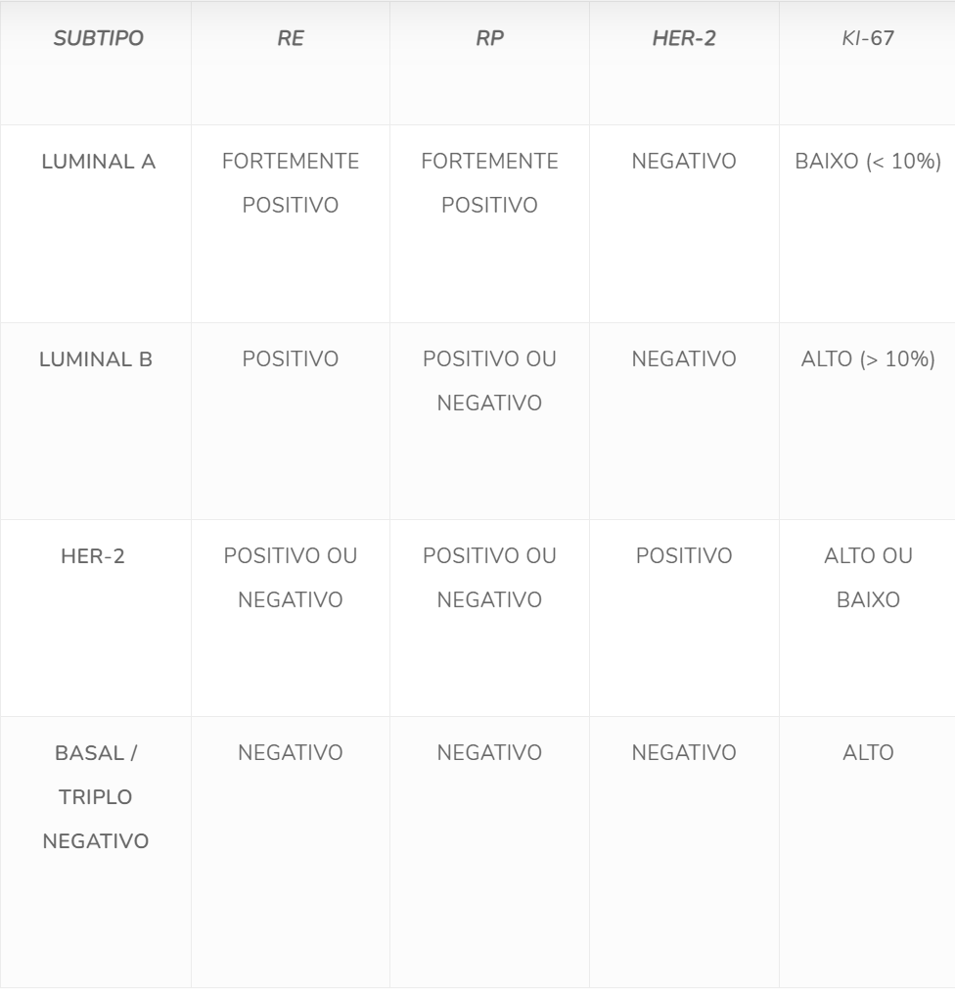

Primeiramente, vamos tirar os id's repetidos, mantendo aqueles que possuem mais dados, essa estratégia foi utilizada de acordo com o feedback que o parceiro deu, indicando que o correto seria manter os id's que tem mais dados. Abaixo teremos a explicação do código:

Inicialmente, iremos agrupar a tabela pelo id e salvando na variável "agrupado" e depois contaremos o número que cada record_id aparece na tabela e salvando isso na variável contagem. Após isso filtraremos apenas os que aparecem duas ou mais vezes isso é representado pela variável duplicados, logo depois a variável repetidos retorna as linhas com os id's repetidos e em seguida criaremos uma lista apenas com os record_id's repetidos. Dentro do for o que foi feito é o seguinte, o i recebe todos os valores de record_ids repetidos(que estão guardados na lista_repetidos) para cada valor de i é contado o número de colunas vazias , assim para um id repetido, ou seja, que aparece mais de uma vez, contaremos o número de colunas vazias para cada uma de suas aparições e logo em seguida ordenaremos isso para que a aparição que tiver menos colunas vazias fique em cima, isso está salvo na variável "colunas_vazias_ordenados", depois salvaremos essa variável em forma de lista e selecionaremos "colunas_vazias_ordenados[1:].index" com o intuito de pegar o número do index da tabela dfh para retirarmos essa linha, é importante notar que estamos pegando a partir do segundo valor que aparece([1:]) , pois queremos eliminar todos os repetidos, deixando apenas o que tem mais dados. Por fim faremos um drop nas linhas encontradas na variável "lista_vazios".

In [ ]:

agrupado = dfh.groupby('record_id')
contagem = agrupado.size()
duplicados = contagem[contagem >= 2]
repetidos = dfh[dfh['record_id'].isin(duplicados.index)]
lista_repetidos = list(repetidos.record_id)

for i in lista_repetidos:
  colunas_vazias = dfh.loc[dfh['record_id'] == i].isna().sum(axis=1)
  colunas_vazias_ordenados = colunas_vazias.sort_values()
  lista_vazios = list(colunas_vazias_ordenados[1:].index)
  dfh = dfh.drop(index =lista_vazios)
dfh.shape

(4272, 14)

In [ ]:
(dfh.isnull().mean().sort_values(ascending=False))*100

indice_h_receptorde_progesterona           89.044944
grau_histologico                           72.027154
receptor_progesterona_quantificacao_pct    62.102060
her2_por_fish                              59.152622
receptorde_estrogenio_quantificacao_pct    57.022472
diagnostico_primario_tipo_histologico      37.640449
ki67_pct                                   20.997191
ki67_maior14pct                            17.509363
receptor_estrogenio                        10.557116
receptor_progesterona                      10.486891
her2_por_ihc                                1.240637
subtipo_tumoral                             0.070225
record_id                                   0.000000
repeat_instance                             0.000000
dtype: float64

In [ ]:
cool = ['record_id', 'repeat_instance', 'diagnostico_primario_tipo_histologico',
       'grau_histologico', 'subtipo_tumoral', 'receptor_estrogenio',
       'receptor_progesterona', 'ki67_maior14pct',
       'receptor_progesterona_quantificacao_pct',
       'receptorde_estrogenio_quantificacao_pct',
       'indice_h_receptorde_progesterona', 'her2_por_ihc', 'her2_por_fish',
       'ki67_pct']
for i in cool:
  informacoes2 = dfh[i].unique()
  print(f'os dados na coluna {i} são:{informacoes2}')
  print('\n')

os dados na coluna record_id são:[  302   710   752 ... 82131 82205 82240]


os dados na coluna repeat_instance são:[1. 2.]


os dados na coluna diagnostico_primario_tipo_histologico são:[nan 'NÃO-ESPECIAL - Carcinoma de mama ductal invasivo (CDI)/SOE'
 'Carcinoma de mama papilifero' 'Carcinoma de mama lobular invasivo'
 'Carcinoma de mama medular' 'Carcinoma de mama lobular in situ' 'outros'
 'Carcinoma de mama mucinoso' 'Carcinoma de mama metaplasico'
 'Carcinoma lobular pleomórfico'
 'Carcinoma de mama misto (ductal e micropapilífero) invasivo'
 'Carcinoma de mama misto (ductal e lobular) invasivo'
 'Adenomioepitelioma maligno'
 'CARCINOMA MAMÁRIO INVASIVO DO TIPO APÓCRINO'
 'Carcinoma de mama micropapilar' 'Carcinoma mamário invasivo multifocal'
 'Carcinoma de mama cistico adenoide' 'Carcinoma de mama tubular'
 'Tumor PHYLLODES maligno']


os dados na coluna grau_histologico são:[nan  3.  2.  1.]


os dados na coluna subtipo_tumoral são:[ 5.  2.  3.  4.  1. nan]


os dados na colun

####2.3.2.4-Tratando missings da coluna 'receptor_progesterona':

In [ ]:
#De acordo com pesquisas geralmente quando o subtipo é HER-2 o paciente possui Receptores hormonais, ou seja, receptor progesterona e estrogenio serão positivos, confirmarei isso na sexta ainda
dfh['receptor_progesterona'] = np.where((dfh['subtipo_tumoral'] == 3 )|(dfh['subtipo_tumoral'] == 4), "negativo" , dfh['receptor_progesterona'])
dfh['receptor_progesterona'] = np.where((dfh['subtipo_tumoral'] == 5 )|(dfh['subtipo_tumoral'] == 1)|(dfh['subtipo_tumoral'] == 2), "positivo" , dfh['receptor_progesterona'])


####2.3.2.5-Tratando missings da coluna 'receptor_progesterona_quantificacao_pct':

In [ ]:
#PRIMEIRAMENTE VAMOS TRANSFORMAR ESSA COLUNA EM NUMÉRICA


#Aqui nós preencheremos os valores vazios da coluna , apenas quando a coluna "receptor_progesterona" for positivo, assim será preenchido mantendo a proporção da coluna
positivo = dfh.loc[dfh['receptor_progesterona'] == 'positivo']
proporcoes_progest = positivo['receptor_progesterona_quantificacao_pct'].value_counts(normalize=True)
valores_aleatorios = np.random.choice(proporcoes_progest.index, size=dfh['receptor_progesterona_quantificacao_pct'].isnull().sum(), p=proporcoes_progest.values)
indices_nulos_positivos = dfh['receptor_progesterona_quantificacao_pct'].isnull() & dfh['receptor_progesterona'].eq('positivo')
if any(indices_nulos_positivos):
    dfh.loc[indices_nulos_positivos, 'receptor_progesterona_quantificacao_pct'] = valores_aleatorios[:sum(indices_nulos_positivos)] #dfh.loc  é mais seguro do que usar np.where porque garante que estamos alterando apenas as linhas que atendem à condição, sem afetar outras linhas em que a condição é falsa. Mas, não significa que np.where nao deve ser utilizado

#Agora colocaremos 0 nos valores vazios da coluna, caso na mesma linha a coluna "receptor_progesterona" seja negativo.
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'].isnull()) & (dfh['receptor_progesterona'] == 'negativo'), "0" , dfh['receptor_progesterona_quantificacao_pct'])

#Agora vamos substituir os valores ruidosos como 'neg', 'NEG', 'inconclusivo'
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == 'neg') | (dfh['receptor_progesterona_quantificacao_pct'] == 'NEG') | (dfh['receptor_progesterona_quantificacao_pct'] == 'inconclusivo'), "0" , dfh['receptor_progesterona_quantificacao_pct'])

#Agora os valores escritos de forma inadequada| (dfh['receptor_progeste
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == '70%') | (dfh['receptor_progesterona_quantificacao_pct'] == '20-70'), "70" , dfh['receptor_progesterona_quantificacao_pct'])
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == '9'), "90",  dfh['receptor_progesterona_quantificacao_pct'])
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == '8'), "80",  dfh['receptor_progesterona_quantificacao_pct'])
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == '7'), "70",  dfh['receptor_progesterona_quantificacao_pct'])
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == '6'), "60",  dfh['receptor_progesterona_quantificacao_pct'])
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == '5'), "50",  dfh['receptor_progesterona_quantificacao_pct'])
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == '4'), "40",  dfh['receptor_progesterona_quantificacao_pct'])
dfh['receptor_progesterona_quantificacao_pct'] = np.where((dfh['receptor_progesterona_quantificacao_pct'] == '1'), "10",  dfh['receptor_progesterona_quantificacao_pct'])

####2.3.2.6-Tratando missings da coluna 'indice_h_receptorde_progesterona':

FAZER UMA ARRAY COM A RELAÇÃO ENTRE OS VALORES DAS DUAS COLUNAS E SUBSTITUIR BASEADO NISSO

In [ ]:
dfh[['indice_h_receptorde_progesterona','receptor_progesterona_quantificacao_pct', 'record_id']]
#Por meio dessa tabela , manualmente veremos essa relação e substituiremos os NaN da tabela baseada nessa relação


,indice_h_receptorde_progesterona,receptor_progesterona_quantificacao_pct,record_id
1,NaN,66,302
3,NaN,0,710
5,NaN,0,752
7,10.0,50,1367
10,NaN,30,1589
...,...,...,...
9056,NaN,0,82123
9059,NaN,0,82124
9061,NaN,0,82131
9063,NaN,0,82205


In [ ]:
dfh['indice_h_receptorde_progesterona'] = np.where((dfh['indice_h_receptorde_progesterona'].isnull()) & (dfh['receptor_progesterona'] == 'negativo'), 0 , dfh['indice_h_receptorde_progesterona'])

receptor_progesterona_pct_to_index = {
    '100': 300,
    '99': 297,
    '98': 294,
    '97': 291,
    '95': 285,
    '94': 282,
    '93': 279,
    '90': 270,
    '85': 255,
    '80': 240,
    '75': 225,
    '70': 210,
    '66': 198,
    '65': 195,
    '60': 180,
    '55': 150,
    '50': 150,
    '40': 120,
    '35': 105,
    '34': 99,
    '33': 99,
    '30': 90,
    '25': 75,
    '20': 60,
    '15': 45,
    '12': 45,
    '10': 30,
    '5':  15,
    '2':  4,
    '0': 0
}
dfh['indice_h_receptorde_progesterona'] = dfh.apply(
    lambda row: row['indice_h_receptorde_progesterona'] if not pd.isna(row['indice_h_receptorde_progesterona']) else 
    receptor_progesterona_pct_to_index.get(row['receptor_progesterona_quantificacao_pct'], row['indice_h_receptorde_progesterona']),
    axis=1
)



####2.3.2.7-Tratando missings da coluna "her2_por_fish":

In [ ]:
dfh['her2_por_fish'] = np.where((dfh['subtipo_tumoral'] == 3)|(dfh['subtipo_tumoral'] == 5), 'amplificado' , dfh['her2_por_fish'])
dfh['her2_por_fish'] = np.where((dfh['subtipo_tumoral'] == 4)| (dfh['subtipo_tumoral'] == 1)| (dfh['subtipo_tumoral'] == 2) , 'sem amplificação' , dfh['her2_por_fish'])
dfh['her2_por_fish'] = np.where((dfh['her2_por_ihc'] == ' +++ (positivo)'), 'amplificado' , dfh['her2_por_fish'])
dfh['her2_por_fish'] = np.where((dfh['her2_por_ihc'] == '0 (negativo)'), 'sem amplificação' , dfh['her2_por_fish'])

####2.3.2.8-Tratando missings da coluna "her2_por_ihc":

In [ ]:
duv =' ++ (duvidoso)'
ind = 'indeterminado'
dfh = dfh.query('her2_por_ihc != @duv & her2_por_ihc != @ind')


In [ ]:
dfh['her2_por_ihc'] = np.where((dfh['subtipo_tumoral'] == 3)|(dfh['subtipo_tumoral'] == 5), ' +++ (positivo)' , dfh['her2_por_ihc'])
dfh['her2_por_ihc'] = np.where((dfh['subtipo_tumoral'] == 4)| (dfh['subtipo_tumoral'] == 1)| (dfh['subtipo_tumoral'] == 2) , '0 (negativo)' , dfh['her2_por_ihc'])

<ipython-input-86-c562ef4f499c>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfh['her2_por_ihc'] = np.where((dfh['subtipo_tumoral'] == 3)|(dfh['subtipo_tumoral'] == 5), ' +++ (positivo)' , dfh['her2_por_ihc'])
<ipython-input-86-c562ef4f499c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfh['her2_por_ihc'] = np.where((dfh['subtipo_tumoral'] == 4)| (dfh['subtipo_tumoral'] == 1)| (dfh['subtipo_tumoral'] == 2) , '0 (negativo)' , dfh['her2_por_ihc'])


####2.3.2.9-Tratando missings da coluna "ki67_maior14pct":

Trataremos essa coluna baseada na coluna ki67_pct, logo onde tiver um valor maior que 14 na coluna citada imputaremos positivo na coluna que estamos tratando, da mesma maneira onde tiver um valor menor que 14 na coluna ki67_pct preencheremos com "negativo" na coluna que estamos tratando.Também trataremos usando subtipo_tumoral, explicado no início do tratamento de missings dfh

In [ ]:
inc = 'inconclusivo'
nao_realizado = 'não realizado'
dfh = dfh.query('ki67_maior14pct != @inc & ki67_maior14pct != @nao_realizado')

In [ ]:
dfh['ki67_maior14pct'] = np.where((dfh['subtipo_tumoral'] == 4 )|(dfh['subtipo_tumoral'] == 2 )|(dfh['subtipo_tumoral'] == 5 ), 'positivo' , dfh['ki67_maior14pct'])
dfh['ki67_maior14pct'] = np.where((dfh['ki67_maior14pct'].isnull()) & (dfh['ki67_pct'] > 14) , 'positivo' , dfh['ki67_maior14pct'])
dfh['ki67_maior14pct'] = np.where((dfh['ki67_maior14pct'].isnull()) & (dfh['ki67_pct'] < 14) , 'negativo' , dfh['ki67_maior14pct'])


#segundo o parceiro, quando o subtipo tumoral for HER2 a coluna ki67_maior14pct pode receber tanto positivo quanto negativo, então preencheremos os valores vazios dessa coluna quando o subtipo tumoral for 3 ou 5 baseado na proporção encontrada atualmente.
her2_positivo = dfh.loc[dfh['her2_por_ihc']== ' +++ (positivo)']
proporcoes_ki = her2_positivo['ki67_maior14pct'].value_counts(normalize=True)
valores_aleatorios_ki = np.random.choice(proporcoes_ki.index, size=dfh['ki67_maior14pct'].isnull().sum(), p=proporcoes_ki.values)
indices_nulos_ki = dfh['ki67_maior14pct'].isnull() & dfh['her2_por_ihc'].eq(' +++ (positivo)')
if any(indices_nulos_ki):
    dfh.loc[indices_nulos_ki, 'ki67_maior14pct'] = valores_aleatorios_ki[:sum(indices_nulos_ki)] #dfh.loc  é mais seguro do que usar np.where porque garante que estamos alterando apenas as linhas que atendem à condição, sem afetar outras linhas em que a condição é falsa. Mas, não significa que np.where nao deve ser utilizado

####2.3.2.10-Tratando missings da coluna 'ki67_pct':

In [ ]:
menor_14 = dfh.loc[dfh['ki67_pct'] <14 ]
menor_14['ki67_pct'].mode()

0    10.0
Name: ki67_pct, dtype: float64

In [ ]:
maior_14 = dfh.loc[dfh['ki67_pct'] > 14 ]
maior_14['ki67_pct'].mode()

0    30.0
Name: ki67_pct, dtype: float64

Por meio da coluna ki67_maior14pct, trataremos essa coluna, pois quando for maior do que 14 substituiremos pela moda dos numeros>14 da coluna ki67_pct. Porém, quando  for negativo substituiremos pela moda dos numeros<14:

In [ ]:
dfh['ki67_pct'] = np.where((dfh['ki67_pct'].isnull()) & (dfh['ki67_maior14pct'] == 'positivo')  , 30 , dfh['ki67_pct']) #ki67_maior14pct é positivo
dfh['ki67_pct'] = np.where((dfh['ki67_pct'].isnull()) & (dfh['ki67_maior14pct'] == 'inconclusivo')  , 30 , dfh['ki67_pct']) #ki67_maior14pct é inconclusivo, mas o subtipo tumoral é 3, logo a probabilidade de ser "positivo" é imensamente maior
dfh['ki67_pct'] = np.where((dfh['ki67_pct'].isnull()) & (dfh['ki67_maior14pct'] == 'não realizado')  , 30 , dfh['ki67_pct']) #ki67_maior14pct é não realizado, mas o subtipo tumoral é 3, logo a probabilidade de ser "positivo" é imensamente maior
dfh['ki67_pct'] = np.where((dfh['ki67_pct'].isnull()) & (dfh['ki67_maior14pct'] == 'negativo') , 10 , dfh['ki67_pct']) #ki67_maior14pct é negativo


####2.3.2.11-Tratando missings da coluna "receptor_estrogenio":

In [ ]:
#De acordo com pesquisas e com o parceiro, geralmente quando o subtipo é HER-2 o paciente nao possui Receptores hormonais, ou seja, receptor estrogenio será negativo
dfh['receptor_estrogenio'] = np.where((dfh['subtipo_tumoral'] == 3 )|(dfh['subtipo_tumoral'] == 4 ), "negativo" , dfh['receptor_estrogenio'])
dfh['receptor_estrogenio'] = np.where((dfh['subtipo_tumoral'] == 5 ), "positivo" , dfh['receptor_estrogenio'])
dfh['receptor_estrogenio'] = dfh['receptor_estrogenio'].fillna("negativo") #tinha apenas um(1) NAN e o seu subtipotumoral é 3 , logo o receptor de estrogenio é negativo


####2.3.2.12-Tratando missings da coluna "receptorde_estrogenio_quantificacao_pct":

In [ ]:
#Agora vamos substituir os valores ruidosos como 'neg', 'NEG'
dfh['receptorde_estrogenio_quantificacao_pct'] = np.where((dfh['receptorde_estrogenio_quantificacao_pct'] == 'neg') | (dfh['receptorde_estrogenio_quantificacao_pct'] == 'NEG'), "0" , dfh['receptorde_estrogenio_quantificacao_pct'])
dfh['receptorde_estrogenio_quantificacao_pct'] = np.where((dfh['receptorde_estrogenio_quantificacao_pct'] == '1-10') , "10" , dfh['receptorde_estrogenio_quantificacao_pct'])
#Quando a coluna receptor estrogenio for negativa colocaremos 0 na coluna de quantificação
dfh['receptorde_estrogenio_quantificacao_pct'] = np.where((dfh['receptorde_estrogenio_quantificacao_pct'].isnull()) & (dfh['receptor_estrogenio'] == 'negativo'), "0" , dfh['receptorde_estrogenio_quantificacao_pct'])

#Vamos tratar mantendo as proporções atuais:
proporcoes_estrog = dfh['receptorde_estrogenio_quantificacao_pct'].value_counts(normalize=True)
valores_aleatorios2 = np.random.choice(proporcoes_estrog.index, size=dfh['receptorde_estrogenio_quantificacao_pct'].isnull().sum(), p=proporcoes_estrog.values)
indices_nulos_positivos2 = dfh['receptorde_estrogenio_quantificacao_pct'].isnull() & dfh['receptor_estrogenio'].eq('positivo')
if any(indices_nulos_positivos2):
    dfh.loc[indices_nulos_positivos2, 'receptorde_estrogenio_quantificacao_pct'] = valores_aleatorios2[:sum(indices_nulos_positivos2)]

####2.3.2.14-Tratando missings da coluna "subtipo_tumoral":

In [ ]:
dfh.loc[dfh['subtipo_tumoral'].isnull()]

,record_id,repeat_instance,diagnostico_primario_tipo_histologico,grau_histologico,subtipo_tumoral,receptor_estrogenio,receptor_progesterona,ki67_maior14pct,receptor_progesterona_quantificacao_pct,receptorde_estrogenio_quantificacao_pct,indice_h_receptorde_progesterona,her2_por_ihc,her2_por_fish,ki67_pct
5718,59104,2.0,NÃO-ESPECIAL - Carcinoma de mama ductal invasi...,2.0,NaN,positivo,positivo,positivo,100,100,300.0,0 (negativo),sem amplificação,17.0
8546,77129,1.0,NÃO-ESPECIAL - Carcinoma de mama ductal invasi...,2.0,NaN,positivo,positivo,positivo,100,100,300.0,+ (negativo),NaN,20.0


In [ ]:
dfh['subtipo_tumoral'] = np.where((dfh['record_id'] == 59104)|(dfh['record_id'] == 77129),2, dfh['subtipo_tumoral'])
dfh['subtipo_tumoral'] = np.where((dfh['record_id'] == 37516),3, dfh['subtipo_tumoral'])

####2.3.2.15-Tratando missings da coluna "diagnostico_primario_tipo_histologico":

In [ ]:
dfh['diagnostico_primario_tipo_histologico'] = dfh['diagnostico_primario_tipo_histologico'].fillna('NÃO-ESPECIAL - Carcinoma de mama ductal invasivo (CDI)/SOE')

####2.3.2.16-Tratamento de outliers da tabela dfh(histopatologia):

Primeiramente iremos converter as colunas que deveriam ser númericas mas estão como categóricas, faremos isso usando a função int() para "remover"(explicação grosseira) as aspas

In [ ]:
transform = []
for n in dfh['receptor_progesterona_quantificacao_pct']:
  n = int(n)
  transform.append(n)
dfh['receptor_progesterona_quantificacao_pct'] = transform
dfh['receptor_progesterona_quantificacao_pct'].dtype

dtype('int64')

In [ ]:
transform = []
for n in dfh['receptorde_estrogenio_quantificacao_pct']:
  n = int(n)
  transform.append(n)
dfh['receptorde_estrogenio_quantificacao_pct'] = transform
dfh['receptorde_estrogenio_quantificacao_pct'].dtype

dtype('int64')

* Identificação de outliers para as colunas numéricas:

In [ ]:
#estamos usando a média +- 3 desvio padrão para identificar outliers , supondo que a distribuicao é normal
numericas = ['receptor_progesterona_quantificacao_pct', 
             'indice_h_receptorde_progesterona',  
             'ki67_pct']
for colu in numericas: 
  media = dfh[colu].mean()
  std = dfh[colu].std()
  higher_limit = media + (3 * std)
  lower_limit = media - (3 * std)
  outliers = dfh[['record_id',colu]][dfh[colu]>higher_limit ]
  outliers2 = dfh[['record_id',colu]][dfh[colu]<lower_limit ]
  print(f'na coluna {colu} o outlier acima é: \n {outliers} \n o outlier abaixo é: \n {outliers2} \n') 

na coluna receptor_progesterona_quantificacao_pct o outlier acima é: 
 Empty DataFrame
Columns: [record_id, receptor_progesterona_quantificacao_pct]
Index: [] 
 o outlier abaixo é: 
 Empty DataFrame
Columns: [record_id, receptor_progesterona_quantificacao_pct]
Index: [] 

na coluna indice_h_receptorde_progesterona o outlier acima é: 
 Empty DataFrame
Columns: [record_id, indice_h_receptorde_progesterona]
Index: [] 
 o outlier abaixo é: 
 Empty DataFrame
Columns: [record_id, indice_h_receptorde_progesterona]
Index: [] 

na coluna ki67_pct o outlier acima é: 
 Empty DataFrame
Columns: [record_id, ki67_pct]
Index: [] 
 o outlier abaixo é: 
 Empty DataFrame
Columns: [record_id, ki67_pct]
Index: [] 



* identificamos que não existem outliers para as colunas numéricas de dfh, utilizando-se da métrica(média +- 3.desvio_padrão)

####2.3.2.17-Encoding 

In [ ]:
dfh['indice_h_receptorde_progesterona'].unique()

array([198.,   0.,  10.,  90., 270., 120., 150., 210., 180., 240.,  60.,
       195.,  30., 300., 285., 140.,  15., 225.,  45.,  99., 255., 294.,
        75.,   4., 132., 297.,  70., 105.,  20., 100.,  40., 160.,  80.,
         2., 282., 200.,   1., 291.,   5., 279.])

In [ ]:
dfh_encoding = dfh[['record_id', 'subtipo_tumoral', 'indice_h_receptorde_progesterona', 'ki67_pct', 'diagnostico_primario_tipo_histologico', 'receptor_estrogenio', 'receptor_progesterona', 'ki67_maior14pct', 'her2_por_fish', 'her2_por_ihc', 'receptorde_estrogenio_quantificacao_pct','receptor_progesterona_quantificacao_pct']]
dfh_encoding.head()


,record_id,subtipo_tumoral,indice_h_receptorde_progesterona,ki67_pct,diagnostico_primario_tipo_histologico,receptor_estrogenio,receptor_progesterona,ki67_maior14pct,her2_por_fish,her2_por_ihc,receptorde_estrogenio_quantificacao_pct,receptor_progesterona_quantificacao_pct
1,302,5.0,198.0,30.0,NÃO-ESPECIAL - Carcinoma de mama ductal invasi...,positivo,positivo,positivo,amplificado,+++ (positivo),90,66
3,710,2.0,0.0,20.0,NÃO-ESPECIAL - Carcinoma de mama ductal invasi...,positivo,positivo,positivo,sem amplificação,0 (negativo),100,0
5,752,3.0,0.0,30.0,NÃO-ESPECIAL - Carcinoma de mama ductal invasi...,negativo,negativo,positivo,amplificado,+++ (positivo),0,0
7,1367,2.0,10.0,40.0,NÃO-ESPECIAL - Carcinoma de mama ductal invasi...,positivo,positivo,positivo,sem amplificação,0 (negativo),60,50
10,1589,5.0,90.0,30.0,NÃO-ESPECIAL - Carcinoma de mama ductal invasi...,positivo,positivo,positivo,amplificado,+++ (positivo),5,30


In [ ]:
dfh_encoding['receptor_estrogenio'] = dfh_encoding['receptor_estrogenio'].replace({
    'negativo': 0,
    'positivo': 1,
})

<ipython-input-102-ac31de82d79e>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfh_encoding['receptor_estrogenio'] = dfh_encoding['receptor_estrogenio'].replace({


In [ ]:
dfh_encoding['receptor_progesterona'] = dfh_encoding['receptor_progesterona'].replace({
    'negativo': 0,
    'positivo': 1,
})

<ipython-input-103-287c88029f94>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfh_encoding['receptor_progesterona'] = dfh_encoding['receptor_progesterona'].replace({


In [ ]:
dfh_encoding['ki67_maior14pct'].unique()

array(['positivo', 'negativo'], dtype=object)

In [ ]:
dfh_encoding['ki67_maior14pct'] = dfh_encoding['ki67_maior14pct'].replace({
    'negativo': 0,
    'positivo': 1,
})

<ipython-input-105-39e42ae579ca>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfh_encoding['ki67_maior14pct'] = dfh_encoding['ki67_maior14pct'].replace({


In [ ]:
dfh_encoding['her2_por_fish'] = dfh_encoding['her2_por_fish'].replace({
    'amplificado': 1,
    'sem amplificação':0,
})

<ipython-input-106-8f15cdbd0464>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfh_encoding['her2_por_fish'] = dfh_encoding['her2_por_fish'].replace({


In [ ]:
dfh['diagnostico_primario_tipo_histologico'].unique()

array(['NÃO-ESPECIAL - Carcinoma de mama ductal invasivo (CDI)/SOE',
       'Carcinoma de mama papilifero',
       'Carcinoma de mama lobular invasivo', 'Carcinoma de mama medular',
       'Carcinoma de mama lobular in situ', 'outros',
       'Carcinoma de mama mucinoso', 'Carcinoma de mama metaplasico',
       'Carcinoma lobular pleomórfico',
       'Carcinoma de mama misto (ductal e micropapilífero) invasivo',
       'Carcinoma de mama misto (ductal e lobular) invasivo',
       'Adenomioepitelioma maligno',
       'CARCINOMA MAMÁRIO INVASIVO DO TIPO APÓCRINO',
       'Carcinoma mamário invasivo multifocal',
       'Carcinoma de mama cistico adenoide',
       'Carcinoma de mama micropapilar', 'Carcinoma de mama tubular',
       'Tumor PHYLLODES maligno'], dtype=object)

In [ ]:
#dummies = pd.get_dummies(dfh_encoding['diagnostico_primario_tipo_histologico'])
#dfh_encoding = pd.concat([dfh_encoding, dummies], axis=1)

In [ ]:
dfh_encoding['her2_por_ihc'] = dfh_encoding['her2_por_ihc'].replace({
    ' +++ (positivo)': 1,
    ' + (negativo)':0,
    '0 (negativo)':0,  
})
dfh_encoding['her2_por_ihc'].value_counts()

<ipython-input-109-54e54b8e76c1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfh_encoding['her2_por_ihc'] = dfh_encoding['her2_por_ihc'].replace({


0    2765
1    1220
Name: her2_por_ihc, dtype: int64

* O código abaixo seleciona as features da tabela DFH

In [ ]:
dfh_final = dfh_encoding[['record_id', 'subtipo_tumoral', 'indice_h_receptorde_progesterona', 'ki67_pct', 'receptor_estrogenio', 'receptor_progesterona','receptor_progesterona_quantificacao_pct','receptorde_estrogenio_quantificacao_pct',  'ki67_maior14pct', 'her2_por_fish', 'her2_por_ihc']
                         ]

dfh_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3985 entries, 1 to 9065
Data columns (total 11 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   record_id                                3985 non-null   int64  
 1   subtipo_tumoral                          3985 non-null   float64
 2   indice_h_receptorde_progesterona         3985 non-null   float64
 3   ki67_pct                                 3985 non-null   float64
 4   receptor_estrogenio                      3985 non-null   int64  
 5   receptor_progesterona                    3985 non-null   int64  
 6   receptor_progesterona_quantificacao_pct  3985 non-null   int64  
 7   receptorde_estrogenio_quantificacao_pct  3985 non-null   int64  
 8   ki67_maior14pct                          3985 non-null   int64  
 9   her2_por_fish                            3984 non-null   float64
 10  her2_por_ihc                             3985 no

In [ ]:
dfh_final = dfh_final.dropna()
dfh_final

,record_id,subtipo_tumoral,indice_h_receptorde_progesterona,ki67_pct,receptor_estrogenio,receptor_progesterona,receptor_progesterona_quantificacao_pct,receptorde_estrogenio_quantificacao_pct,ki67_maior14pct,her2_por_fish,her2_por_ihc
1,302,5.0,198.0,30.0,1,1,66,90,1,1.0,1
3,710,2.0,0.0,20.0,1,1,0,100,1,0.0,0
5,752,3.0,0.0,30.0,0,0,0,0,1,1.0,1
7,1367,2.0,10.0,40.0,1,1,50,60,1,0.0,0
10,1589,5.0,90.0,30.0,1,1,30,5,1,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...
9056,82123,3.0,0.0,20.0,0,0,0,0,1,1.0,1
9059,82124,3.0,0.0,30.0,0,0,0,0,1,1.0,1
9061,82131,3.0,0.0,50.0,0,0,0,0,1,1.0,1
9063,82205,4.0,0.0,90.0,0,0,0,0,1,0.0,0


###2.3.3-Resultado


In [ ]:
dfh_final_profiling = ProfileReport(dfh_final, title="DFH_final Profiling Report")
dfh_final_profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##2.4. DF Demográficos (dfd)

###2.4.1-Overview

In [ ]:
dfd_profiling = ProfileReport(dfd, title="DFD Profiling Report")
dfd_profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###2.4.1 Renomeando as colunas:

In [ ]:
dfd = dfd.rename(columns={
                          'Record ID':'record_id', 
                          'Repeat Instrument':'repeat_instrument', 
                          'Repeat Instance':'repeat_instance', 
                          'Escolaridade':'escolaridade',
                          'Idade do paciente ao primeiro diagnóstico':'idade_primeiro_diagnostico', 
                          'Sexo':'sexo',
                          'Raça declarada (Biobanco)':'raca', 
                          'UF de nascimento do paciente':'UF_nascimento',
                          'UF de residência do paciente':'UF_residencia',
                          'Data da última informação sobre o paciente':'data_da_ultima_informacao',
                          'Última informação do paciente':'ultima_informacao',
                          'Tempo de seguimento (em dias) - desde o último tumor no caso de tumores múltiplos    [dt_pci]':'tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci',
                          'Já ficou grávida?':'engravidou', 
                          'Quantas vezes ficou gráfida?':'quantas_vezes_ficou_gravida', 
                          'Número de partos':'numero_partos',
                          'Idade na primeira gestação':'idade_primeira_gestacao', 
                          'Abortou':'abortou',
                          'Amamentou na primeira gestação?':'amamentou_na_primeira_gestacao', 
                          'Por quanto tempo amamentou?':'tempo_de_amamentacao',
                          'Historia familiar de câncer relacionado a síndrome de câncer de mama e ovário hereditária? (choice=Não)': 'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao',
                          'Historia familiar de câncer relacionado a síndrome de câncer de mama e ovário hereditária? (choice=Sim - 1º grau, apenas 1 caso)': 'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso',
                          'Historia familiar de câncer relacionado a síndrome de câncer de mama e ovário hereditária? (choice=Sim - 1º grau, mais de 1 caso)': 'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso',
                          'Historia familiar de câncer relacionado a síndrome de câncer de mama e ovário hereditária? (choice=Sim - 2º grau, apenas 1 caso)': 'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_apenas_1_caso',
                          'Historia familiar de câncer relacionado a síndrome de câncer de mama e ovário hereditária? (choice=Sim - 2º grau, mais de 1 caso)': 'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_mais_1_caso',
                          'Idade da primeira mentruação': 'idade_primeira_menstruacao',
                          'Faz uso de métodos contraceptivo?':'usou_contraceptivo?',
                          'Qual método? (choice=Pílula anticoncepcional)':'qual_metodo_choice_pilula_anticoncepcional',
                          'Qual método? (choice=DIU)':'qual_metodo_choice_diu', 
                          'Qual método? (choice=camisinha)':'qual_metodo_choice_camisinha',
                          'Qual método? (choice=outros)':'qual_metodo_choice_outros', 
                          'Qual método? (choice=não informou)':'qual_metodo_choice_nao_informou',
                          'Já fez uso de drogas?':'ja_usou_droga?', 
                          'Atividade Física':'atividade_fisica', 
                          'Consumo de tabaco':'consumo_tabaco',
                          'Consumo de álcool':'consumo_alcool', 
                          'Possui histórico familiar de câncer?':'tem_historico_de_cancer?',
                          'Grau de parentesco de familiar com cancer? (choice=primeiro (pais, irmãos, filhos))':'grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos',
                          'Grau de parentesco de familiar com cancer? (choice=segundo (avós, tios e netos))':'grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos',
                          'Grau de parentesco de familiar com cancer? (choice=terceiro (bisavós, tio avós, primos, sobrinhos))':'grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos',
                          'Regime de Tratamento':'tratamento', 
                          'Hormonioterapia ':'hormonioterapia', 
                          'Data da cirurgia':'data_cirurgia',
                          'Tipo de terapia anti-HER2 neoadjuvante':'tipo_terapia_anti-her2_neoadjuvante', 
                          'Radioterapia':'radioterapia',
                          'Data de início do tratamento quimioterapia':'data_de_inicio_quimioterapia',
                          'Esquema de hormonioterapia':'esquema_hormonioterapia',
                          'Data do início Hormonioterapia adjuvante':'data_do_inicio_hormonioterapia_adjuvante',
                          'Data de início da Radioterapia':'data_inicio_radioterapia'
                          })

### 2.4.2 Limpeza:

In [ ]:
# Remoção de colunas não informativas
removidas = ['repeat_instrument',
             'repeat_instance',
             'UF_nascimento',
             'UF_residencia',
             'numero_partos',
             'data_do_inicio_hormonioterapia_adjuvante',
             'qual_metodo_choice_diu',
             'qual_metodo_choice_camisinha',
             'qual_metodo_choice_outros',
             'qual_metodo_choice_nao_informou',
             'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_apenas_1_caso',
             'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_mais_1_caso']
#Mostrando os dados das colunas que serão removidas
for col in removidas:
  informacoes = dfd[col].unique()
  print(f'os dados na coluna {col} são:{informacoes}')
  print('\n')

print('numero_partos:', dfd['numero_partos'].unique(),'\n')
print('data_do_inicio_hormonioterapia_adjuvante', dfd['data_do_inicio_hormonioterapia_adjuvante'].unique(),'\n')

dfd = dfd.drop(['repeat_instrument',
                'repeat_instance',
                'UF_nascimento',
                'UF_residencia',
                'data_do_inicio_hormonioterapia_adjuvante',
                'numero_partos',
                'qual_metodo_choice_diu',
                'qual_metodo_choice_camisinha',
                'qual_metodo_choice_outros',
                'qual_metodo_choice_nao_informou',
                'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_apenas_1_caso',
                'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_mais_1_caso', 
                'usou_contraceptivo?'], axis=1)

os dados na coluna repeat_instrument são:[nan]


os dados na coluna repeat_instance são:[nan]


os dados na coluna UF_nascimento são:[nan 'SP']


os dados na coluna UF_residencia são:[nan 'SP']


os dados na coluna numero_partos são:[nan  2.  1.]


os dados na coluna data_do_inicio_hormonioterapia_adjuvante são:[nan '2013-01-07' '2021-06-24']


os dados na coluna qual_metodo_choice_diu são:['Unchecked']


os dados na coluna qual_metodo_choice_camisinha são:['Unchecked']


os dados na coluna qual_metodo_choice_outros são:['Unchecked']


os dados na coluna qual_metodo_choice_nao_informou são:['Unchecked']


os dados na coluna historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_apenas_1_caso são:['Unchecked']


os dados na coluna historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_mais_1_caso são:['Unchecked']


numero_partos: [nan  2.  1.] 

data_do_inicio_hormonioterapia_adjuvante [nan '2013-01-07' '20

Após uma análise dos conteúdos de cada coluna, removeremos as colunas com nenhuma informação , assim como as que possuem apenas um tipo de dado e as que possuem menos de 5 linhas preenchidas, tendo em vista que não estão nos "dizendo" nada:


* repeat_instrument(possui apenas NaN)

* repeat_instance(possui apenas NaN)

* UF_nascimento(possui apenas NaN e SP)

* UF_residencia(possui apenas NaN e SP)

* numero_partos(possui apenas 2 linhas preenchidas)

* data_do_inicio_hormonioterapia_adjuvante(possui apenas 2 linhas preenchidas)

* qual_metodo_choice_diu(tem apenas "unchecked")

* qual_metodo_choice_camisinha(tem apenas "unchecked")

* qual_metodo_choice_outros(tem apenas "unchecked")

* qual_metodo_choice_nao_informou(tem apenas "unchecked")

* usou_contraceptivo?(possui apenas 3 linhas preenchidas, ou seja , 99.9 % das linhas estão vazias)

* historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_2_grau_apenas_1_caso(tem apenas "unchecked")

* repeat_instrument da tabela dfh(possui apenas um tipo de dado)

* repeat_instrument da tabela dfpa(possui apenas um tipo de dado)

* repeat_instrument da tabela dfrt(possui apenas um tipo de dado)

In [ ]:
dfd.columns

Index(['record_id', 'escolaridade', 'idade_primeiro_diagnostico', 'sexo',
       'raca', 'data_da_ultima_informacao', 'ultima_informacao',
       'tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci',
       'engravidou', 'quantas_vezes_ficou_gravida', 'idade_primeira_gestacao',
       'abortou', 'amamentou_na_primeira_gestacao', 'tempo_de_amamentacao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso',
       'idade_primeira_menstruacao',
       'qual_metodo_choice_pilula_anticoncepcional', 'ja_usou_droga?',
       'atividade_fisica', 'consumo_tabaco', 'consumo_alcool',
       'tem_historico_de_cancer?',
       'grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filho

In [ ]:
cool = ['record_id', 'escolaridade', 'idade_primeiro_diagnostico', 'sexo',
       'raca', 'data_da_ultima_informacao', 'ultima_informacao',
       'tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci',
       'engravidou', 'quantas_vezes_ficou_gravida', 'idade_primeira_gestacao',
       'abortou', 'amamentou_na_primeira_gestacao', 'tempo_de_amamentacao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso',
       'idade_primeira_menstruacao',
       'qual_metodo_choice_pilula_anticoncepcional', 'ja_usou_droga?',
       'atividade_fisica', 'consumo_tabaco', 'consumo_alcool',
       'tem_historico_de_cancer?',
       'grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos',
       'grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos',
       'grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos',
       'tratamento', 'hormonioterapia', 'data_cirurgia',
       'tipo_terapia_anti-her2_neoadjuvante', 'radioterapia',
       'data_de_inicio_quimioterapia', 'esquema_hormonioterapia',
       'data_inicio_radioterapia']
for i in cool:
  informacoes2 = dfd[i].unique()
  print(f'os dados na coluna {i} são:{informacoes2}')
  print('\n')

os dados na coluna record_id são:[  302   710   752 ... 82131 82205 82240]


os dados na coluna escolaridade são:['ENS. FUNDAMENTAL INCOMPLETO' 'ENSINO MÉDIO' 'ENS. FUNDAMENTAL COMPLETO'
 'IGNORADA' 'SUPERIOR' 'ANALFABETO' nan]


os dados na coluna idade_primeiro_diagnostico são:[51. 58. 56. 63. 42. 43. 52. 40. 60. 29. 36. 75. 45. 31. 30. 71. 48. 50.
 39. 49. 61. 47. 55. 74. 37. 59. 32. 64. 44. 35. 57. 62. 54. 68. 33. 78.
 27. 28. 46. 69. 80. 34. 82. 70. 41. 65. 73. 53. 72. 22. 24. 66. 26. 38.
 81. 79. 25. 83. 86. 67. 84. 91. 76. 77. 89. 85. 93. 87. 92. 23. 88. 90.
 97. 95. 98. nan 96.]


os dados na coluna sexo são:['Feminino' nan 'Masculino']


os dados na coluna raca são:[nan 'Branco' 'Pardo' 'Negro' 'Outro' 'Asiático']


os dados na coluna data_da_ultima_informacao são:['2014-04-26' '2016-11-17' '2019-05-02' ... '2021-10-04' '2022-02-15'
 '2022-06-10']


os dados na coluna ultima_informacao são:['Obito por câncer' 'Vivo, SOE' 'Vivo, com câncer'
 'Óbito por outras causas, SOE' nan]


In [ ]:
teste = pd.merge(dfrt[['record_id','recidiva','cinco_anos_sem_rencidiva', 'delta_recidiva_tratamento']], dfd[['record_id','ultima_informacao']], on='record_id', how= 'inner')
nao = 'Não'
sim = 'Sim'
vivo = 'Vivo, com câncer'
teste.query('recidiva == @nao & ultima_informacao == @vivo' )


,record_id,recidiva,cinco_anos_sem_rencidiva,delta_recidiva_tratamento,ultima_informacao
6,1843,Não,1,NaT,"Vivo, com câncer"
23,2580,Não,1,NaT,"Vivo, com câncer"
42,4437,Não,1,NaT,"Vivo, com câncer"
44,4582,Não,1,NaT,"Vivo, com câncer"
46,4606,Não,1,NaT,"Vivo, com câncer"
...,...,...,...,...,...
4228,81996,Não,1,NaT,"Vivo, com câncer"
4239,82029,Não,1,NaT,"Vivo, com câncer"
4241,82032,Não,1,NaT,"Vivo, com câncer"
4252,82077,Não,1,NaT,"Vivo, com câncer"


In [ ]:
dfd['esquema_hormonioterapia'].value_counts()

Inibidor de aromatase isolado       5
Switch: tamoxifeno seguido de IA    4
Tamoxifeno isolado                  3
Name: esquema_hormonioterapia, dtype: int64

###  2.4.3 Tratamento de Missings da tabela dfd (dados demográficos):

In [ ]:
# Verificando a porcentagem de nulos por coluna
dfd.isnull().mean().sort_values(ascending=False)
# as colunas tratamento, data de inicio quimioterapia, data inicio radioterapia , data cirurgia e radioterapia poderão ser tratados quando o merge com a tabela dfrt for feito

hormonioterapia                                                                                                 0.999298
esquema_hormonioterapia                                                                                         0.997191
quantas_vezes_ficou_gravida                                                                                     0.989700
abortou                                                                                                         0.987828
ja_usou_droga?                                                                                                  0.965122
tem_historico_de_cancer?                                                                                        0.955524
consumo_alcool                                                                                                  0.952247
consumo_tabaco                                                                                                  0.950375
raca                            

#### 2.4.3.1Tratando missings da coluna "tem_historico_de_cancer?":

In [ ]:
#dfd['tem_historico_de_cancer?'] = dfd['tem_historico_de_cancer?'].fillna('Não informado')


#### 2.4.3.2 Tratando missings da coluna "raca":

In [ ]:
correlacao = dfd['raca'].value_counts(normalize=True)
random = np.random.choice(correlacao.index, size=dfd['raca'].isnull().sum(), p=correlacao.values)
dfd.loc[dfd['raca'].isnull(), 'raca'] = pd.Series(random)
#dfd['raca']

print(dfd['raca'].isnull().sum())

proporcao = []
for i in range(0, 95):
  proporcao.append('Branco')
for i in range(0, 72):
  proporcao.append('Negro')
for i in range(0, 44):
  proporcao.append('Pardo')
for i in range(0, 13):
  proporcao.append('Outro')
for i in range(0, 6):
  proporcao.append('Asiático')

import random

random.shuffle(proporcao)

def apply_proporcao(row):
  row['raca'] = proporcao[0]
  proporcao.pop(0)
  return row

dfd.loc[dfd['raca'].isnull()] = dfd.loc[dfd['raca'].isnull()].apply(apply_proporcao, axis = 1)

230


#### 2.4.3.3 Tratando missings da coluna "sexo":

In [ ]:
dfd['sexo'] = dfd['sexo'].fillna('Feminino')

#### 2.4.3.4 Tratando os missings da coluna "idade_primeiro_diagnostico":

In [ ]:
idade_diag_moda = dfd['idade_primeiro_diagnostico'].mode()
dfd['idade_primeiro_diagnostico'] = np.where((dfd['idade_primeiro_diagnostico'].isnull()), idade_diag_moda, dfd['idade_primeiro_diagnostico'])

 #### 2.4.3.5 Tratando missings da coluna "data_da_ultima_informacao":

In [ ]:
dfd['data_da_ultima_informacao'] = np.where((dfd['data_da_ultima_informacao'].isnull()) , dfd['data_cirurgia'] , dfd['data_da_ultima_informacao'])

#### 2.4.3.6 Tratando missings da coluna "tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci":

In [ ]:
dfd['tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci'] = dfd['tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci'].fillna(1407)#esse valor é a moda de menor valor(existem duas modas)

#### 2.4.3.7 Tratando missings das colunas "consumo_alcool" e "consumo_tabaco":

In [ ]:
#dfd['consumo_alcool'] = dfd['consumo_alcool'].fillna('não-informado')
#dfd['consumo_tabaco'] = dfd['consumo_tabaco'].fillna('não-informado')

####2.4.3.8 Tratando missings da coluna "escolaridade":

In [ ]:
#dfd['escolaridade'] = dfd['escolaridade'].fillna('IGNORADA')

#### 2.4.3.9 Tratando missings da coluna "atividade_fisica":

In [ ]:
#dfd['atividade_fisica'] = dfd['atividade_fisica'].fillna('não-informado')

#### 2.4.3.10 Tratando missings da coluna "ja_usou_droga?":

In [ ]:
#dfd['ja_usou_droga?'] = dfd['ja_usou_droga?'].fillna('não-informado')

#### 2.4.3.11 Tratando missings das colunas "engravidou", "amamentou_na_primeira_gestação", "tempo_de_amamentacao":

In [ ]:
dfd['engravidou'] = np.where((dfd['engravidou'].isnull()) & (dfd['amamentou_na_primeira_gestacao'] == 'Sim'), 'Sim' , dfd['engravidou'])
dfd['engravidou'] = np.where((dfd['engravidou'].isnull()) & (dfd['amamentou_na_primeira_gestacao'] == 'Não'), 'Não' , dfd['engravidou'])
dfd['engravidou'] = np.where((dfd['engravidou'].isnull()) & (dfd['tempo_de_amamentacao'] > 0), 'Sim' , dfd['engravidou'])
dfd['engravidou'] = np.where((dfd['engravidou'].isnull()) & (dfd['sexo'] == 'Masculino'), 'Não' , dfd['engravidou'])

dfd['amamentou_na_primeira_gestacao'] = np.where((dfd['amamentou_na_primeira_gestacao'].isnull()) & (dfd['tempo_de_amamentacao'] > 0), 'Sim' , dfd['amamentou_na_primeira_gestacao'])
dfd['amamentou_na_primeira_gestacao'] = np.where((dfd['amamentou_na_primeira_gestacao'].isnull()) & (dfd['engravidou'] == 'Sim'), 'Sim' , dfd['amamentou_na_primeira_gestacao'])#visto que a maioria das mulheres que engravidaram amamentaram na primeira gestação em comparação com as que não amamentaram forma uma relação de 782/136
dfd['amamentou_na_primeira_gestacao'] = np.where((dfd['amamentou_na_primeira_gestacao'].isnull()) & (dfd['engravidou'] == 'Não'), 'Não' , dfd['amamentou_na_primeira_gestacao'])
dfd['tempo_de_amamentacao'] = np.where((dfd['tempo_de_amamentacao'].isnull()) & (dfd['amamentou_na_primeira_gestacao'] == 'Sim'), dfd['tempo_de_amamentacao'].mode(), dfd['tempo_de_amamentacao'])
dfd['tempo_de_amamentacao'] = np.where((dfd['tempo_de_amamentacao'].isnull()) & (dfd['amamentou_na_primeira_gestacao'] == 'Não'), 0 , dfd['tempo_de_amamentacao'])
dfd['tempo_de_amamentacao'] = np.where((dfd['tempo_de_amamentacao'].isnull()) & (dfd['engravidou'] == 'Não'), 0 , dfd['tempo_de_amamentacao'])

#dfd['engravidou'] = np.where((dfd['engravidou'].isnull()), "Não informado" , dfd['engravidou'])
#dfd['amamentou_na_primeira_gestacao'] = np.where((dfd['amamentou_na_primeira_gestacao'].isnull()), "Não informado" , dfd['amamentou_na_primeira_gestacao'])
dfd['tempo_de_amamentacao'] = np.where((dfd['tempo_de_amamentacao'].isnull()), 0 , dfd['tempo_de_amamentacao'])


#### 2.4.3.12 Tratando missings da coluna "quantas_vezes_ficou_gravida":

In [ ]:
moda = dfd['quantas_vezes_ficou_gravida'].mode()
print(moda)
dfd['quantas_vezes_ficou_gravida'] = np.where((dfd['quantas_vezes_ficou_gravida'].isnull()) & (dfd['engravidou'] == 'Sim'), moda , dfd['quantas_vezes_ficou_gravida'])
dfd['quantas_vezes_ficou_gravida'] = np.where((dfd['quantas_vezes_ficou_gravida'].isnull()) & (dfd['engravidou'] == 'Não'), 0 , dfd['quantas_vezes_ficou_gravida'])
#dfd['quantas_vezes_ficou_gravida'] = np.where((dfd['quantas_vezes_ficou_gravida'].isnull()) & (dfd['engravidou'] == 'Não informado'), -1 , dfd['quantas_vezes_ficou_gravida'])


0    1.0
Name: quantas_vezes_ficou_gravida, dtype: float64


#### 2.4.3.13 Tratando missings da coluna "abortou":

In [ ]:
dfd['abortou'] = np.where((dfd['abortou'].isnull()) & (dfd['amamentou_na_primeira_gestacao'] == 'Sim') | (dfd['tempo_de_amamentacao'] > 0) , 'Não' , dfd['abortou'])
dfd['abortou'] = np.where((dfd['abortou'].isnull()) & (dfd['sexo'] == 'Masculino') , 'Não(homem)' , dfd['abortou'])
#dfd['abortou'] = np.where((dfd['abortou'].isnull()) , 'Não-informado' , dfd['abortou'])

#### 2.4.3.14 Tratando missings da coluna "ultima_informacao":

In [ ]:
# Analisando manualmente vimos que essa coluna possui apenas duas linhas vazias, verificando na outra tabela vimos que um dos pacientes teve metastase para diversos orgãos e a outra não retornou ao hospital, indicando que não realizou o tratamento
dfd['ultima_informacao'] = dfd['ultima_informacao'].fillna('Obito por câncer')

####2.4.3.15 Tratando missings da coluna "idade_primeira_menstruacao":

In [ ]:
dfd['idade_primeira_menstruacao'] = np.where((dfd['idade_primeira_menstruacao'].isnull()) , 13 , dfd['idade_primeira_menstruacao']) 
# 13 é a idade média de menstruação no Brasil, não usamos a média, mediana ou moda da coluna, pois essa estava com poucos dados
#ATENÇÃO: quando for fazer o encoding, devemos substituir o idade_primeira_menstruação das linhas que tem o 'sexo' == Masculino por "não-menstrua"


#### 2.4.3.16 Tratando missings da coluna "idade_primeira_gestacao":

In [ ]:

idade_gest = dfd['idade_primeira_gestacao'].mode()
dfd['idade_primeira_gestacao'] = np.where((dfd['idade_primeira_gestacao'].isnull()) & (dfd['engravidou'] == 'Sim') , idade_gest , dfd['idade_primeira_gestacao'])
dfd['idade_primeira_gestacao'] = np.where((dfd['idade_primeira_gestacao'].isnull()) & (dfd['engravidou'] == 'Não') | (dfd['engravidou'] == 'Não informado') , -1 , dfd['idade_primeira_gestacao'])

### 2.4.4 Tratando missings da coluna "tipo_terapia_anti-her2_neoadjuvante":

De acordo com o parceiro, essa coluna tem relação com a coluna "subtipo_tumoral" da tabela dfh, da seguinte forma: quando o paciente tem subtipo tumoral igual a 3 ou 5, significa que o seu tummor é do tipo HER2, logo ele realizará a terapia anti-her2, os outros subtipos NÃO realizaram esse tratamento.Faremos um merge entre algumas colunas da tabela de dados histopatologicos (dfh) e  de dados demográficos (dfd) pois na dfh tem informações que completarão a coluna citada acima.

In [ ]:
coluna_dfh = dfh[['subtipo_tumoral', 'record_id']]
tipo_terapia = dfd[['tipo_terapia_anti-her2_neoadjuvante', 'record_id']]
merge_terapia = pd.merge(coluna_dfh, tipo_terapia, on='record_id', how= 'right')


In [ ]:
merge_terapia['tipo_terapia_anti-her2_neoadjuvante'] = np.where((merge_terapia['tipo_terapia_anti-her2_neoadjuvante'].isnull()) & (merge_terapia['subtipo_tumoral'] == 1) | (merge_terapia['subtipo_tumoral'] == 2) | (merge_terapia['subtipo_tumoral'] == 4) , 'não realizou' , merge_terapia['tipo_terapia_anti-her2_neoadjuvante'])
merge_terapia['tipo_terapia_anti-her2_neoadjuvante'] = np.where((merge_terapia['tipo_terapia_anti-her2_neoadjuvante'].isnull()) & (merge_terapia['subtipo_tumoral'] == 3) , 'Trastuzumabe' , merge_terapia['tipo_terapia_anti-her2_neoadjuvante'])
merge_terapia['tipo_terapia_anti-her2_neoadjuvante'] = np.where((merge_terapia['tipo_terapia_anti-her2_neoadjuvante'].isnull()) & (merge_terapia['subtipo_tumoral'] == 5) , 'Trastuzumabe + Pertuzumabe' , merge_terapia['tipo_terapia_anti-her2_neoadjuvante'])
dfd['tipo_terapia_anti-her2_neoadjuvante'] = merge_terapia['tipo_terapia_anti-her2_neoadjuvante']

### 2.4.5 Tratando missings das colunas "radioterapia", "data_inicio_radioterapia" , 'data_de_inicio_quimioterapia" , "tratamento", "esquema_hormonioterapia", "hormonioterapia" , "data_cirurgia":

Merge entre algumas colunas da tabela de registro do tumor (dfrt) e algumas da tabela de dados demográficos (dfd) pois na dfrt tem informações que completarão as colunas citadas acima.

In [ ]:
dfd['data_inicio_radioterapia'] = pd.to_datetime(dfd['data_inicio_radioterapia'], format='%Y-%m-%d')
dfd['data_de_inicio_quimioterapia'] = pd.to_datetime(dfd['data_de_inicio_quimioterapia'], format='%Y-%m-%d')
dfd['data_cirurgia'] = pd.to_datetime(dfd['data_cirurgia'], format='%Y-%m-%d')

In [ ]:
# Merge entre as colunas requeridas
colunas_dfrt = dfrt
colunas_dfd = dfd[['record_id', 'tratamento', 'radioterapia', 'data_inicio_radioterapia', 'data_de_inicio_quimioterapia', 'esquema_hormonioterapia', 'hormonioterapia' , 'data_cirurgia']]
merge_colunas = pd.merge(colunas_dfrt, colunas_dfd, on='record_id', how= 'right')

####2.4.5.1 Tratando os missings da coluna "tratamento":

In [ ]:
merge_colunas['tratamento'] = np.where((merge_colunas['tratamento'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Radioterapia') , 'Radioterapia' , merge_colunas['tratamento'])
merge_colunas['tratamento'] = np.where((merge_colunas['tratamento'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Quimioterapia') , 'Quimioterapia' , merge_colunas['tratamento'])
merge_colunas['tratamento'] = np.where((merge_colunas['tratamento'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Nenhum tratamento') , 'Nenhum tratamento' , merge_colunas['tratamento'])
merge_colunas['tratamento'] = np.where((merge_colunas['tratamento'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia') , 'Cirurgia' , merge_colunas['tratamento'])

In [ ]:
from datetime import timedelta
def tratando_tratamento(row):
  if row['tratamento'] != 'Terapia Neoadjuvante' and row['tratamento'] != 'Terapia Adjuvante' and row['tratamento'] != 'Quimioterapia' and row['tratamento'] != 'Radioterapia' and row['tratamento'] != 'Cirurgia' and row['tratamento'] != 'Nenhum Tratamento' :
    if row['data_cirurgia'] == row['data_do_tratamento'] or row['data_cirurgia'] < row['data_de_inicio_quimioterapia'] or row['data_cirurgia'] - row['data_do_diagnostico'] <= timedelta(days = 180):
      row['tratamento'] = 'Terapia Adjuvante'
    elif row['data_de_inicio_quimioterapia'] == row['data_do_tratamento'] or row['data_cirurgia'] > row['data_de_inicio_quimioterapia']:
      row['tratamento'] = 'Terapia Neoadjuvante'
    elif row['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Outras combinações':
      row['tratamento'] = 'Outras combinações'

  return row

merge_colunas = merge_colunas.apply(tratando_tratamento, axis = 1)
merge_colunas['tratamento'].isnull().mean()

0.04892322097378277

In [ ]:
dfd['tratamento'] = merge_colunas['tratamento']

In [ ]:
adj = 'Terapia Adjuvante'
Neo = 'Terapia Neoadjuvante'
dfd = dfd.loc[(dfd['tratamento']== 'Terapia Adjuvante') | (dfd['tratamento'] == 'Terapia Neoadjuvante')]
dfd['tratamento'].value_counts()

Terapia Adjuvante       1861
Terapia Neoadjuvante    1366
Name: tratamento, dtype: int64

#### 2.4.5.2 Tratando os missings da coluna "radioterapia":

In [ ]:
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia + Radio + Quimio'), 'Sim' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia + Radio + Quimio + Hormonio'), 'Sim' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia + Radioterapia'), 'Sim' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Radioterapia + Quimioterapia'), 'Sim' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Radioterapia'), 'Sim' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'] == 'Não') & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Radioterapia'), 'Sim' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'] == 'Não') & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia + Radio + Quimio + Hormonio'), 'Sim' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia + Quimioterapia'), 'Não' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Quimioterapia'), 'Não' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Nenhum tratamento'), 'Não' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia'), 'Não' , merge_colunas['radioterapia'])
merge_colunas['radioterapia'] = np.where((merge_colunas['radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Outras combinações'), 'Não' , merge_colunas['radioterapia'])

# Agora faremos a coluna radioterapia da tabela dfd receber a coluna radioterapia da tabela merge_colunas, que ja está tratada
dfd['radioterapia'] = merge_colunas['radioterapia']

#### 2.4.5.3 Tratando os missings da coluna "data_cirurgia":

In [ ]:
merge_colunas['data_cirurgia'] = np.where((merge_colunas['data_cirurgia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia'), merge_colunas['data_do_tratamento'] , merge_colunas['data_cirurgia'])
dfd['data_cirurgia'] = merge_colunas['data_cirurgia']
dfd['data_cirurgia'] = dfd['data_cirurgia'].fillna("Não informado")
#usar tambem radio+quimio+cirurgia e a coluna tratamento de dfd

#### 2.4.5.4 Tratando os missings da coluna "data_inicio_radioterapia":

In [ ]:
merge_colunas['data_inicio_radioterapia'] = np.where((merge_colunas['data_inicio_radioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Radioterapia'), merge_colunas['data_do_tratamento'] , merge_colunas['data_inicio_radioterapia'])
dfd['data_inicio_radioterapia'] = merge_colunas['data_inicio_radioterapia']
dfd['data_inicio_radioterapia'] = dfd['data_inicio_radioterapia'].fillna("Não informado")

#### 2.4.5.5 Tratando os missings da coluna "data_de_inicio_quimioterapia":

In [ ]:
merge_colunas['data_de_inicio_quimioterapia'] = np.where((merge_colunas['data_de_inicio_quimioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Quimioterapia'), merge_colunas['data_do_tratamento'] , merge_colunas['data_de_inicio_quimioterapia'])
dfd['data_de_inicio_quimioterapia'] = merge_colunas['data_de_inicio_quimioterapia'] #com isso resgatamos cerca de 130 linhas
dfd['data_de_inicio_quimioterapia'] = dfd['data_de_inicio_quimioterapia'].fillna("Não informado")

#### 2.4.5.6 Tratando os missings da coluna "esquema_hormonioterapia":

In [ ]:
merge_colunas['esquema_hormonioterapia'] = np.where((merge_colunas['esquema_hormonioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] != 'Cirurgia + Radio + Quimio + Hormonio') & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] != 'Outras combinações'), "Não realizou" , merge_colunas['esquema_hormonioterapia'])
merge_colunas['esquema_hormonioterapia'] = np.where((merge_colunas['esquema_hormonioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Outras combinações'), "Outras combinacoes" , merge_colunas['esquema_hormonioterapia'])
#aqui faremos um preenchimento com uma distribuição aleatória dos valores, pois a contagem dos dados para essa coluna está muito perto para cada um dos dados.
#proporcoes = merge_colunas['esquema_hormonioterapia'].value_counts(normalize=True)
#valores_aleatorios = np.random.choice(proporcoes.index, size=merge_colunas['esquema_hormonioterapia'].isnull().sum(), p=proporcoes.values)
#dfd['esquema_hormonioterapia'] = merge_colunas['esquema_hormonioterapia']
#dfd['esquema_hormonioterapia'] = dfd['esquema_hormonioterapia'].fillna(pd.Series(valores_aleatorios))



proporcao = []
for i in range(0, 342):
  proporcao.append('Inibidor de aromatase isolado')
for i in range(0, 273):
  proporcao.append('Switch: tamoxifeno seguido de IA')
for i in range(0, 274):
  proporcao.append('Tamoxifeno isolado')

import random

random.shuffle(proporcao)

print(len(merge_colunas.loc[merge_colunas['esquema_hormonioterapia'].isnull()]))

def apply_proporcao(row):
  row['esquema_hormonioterapia'] = proporcao[0]
  proporcao.pop(0)
  return row

merge_colunas.loc[merge_colunas['esquema_hormonioterapia'].isnull()] = merge_colunas.loc[merge_colunas['esquema_hormonioterapia'].isnull()].apply(apply_proporcao, axis = 1)

889


In [ ]:
dfd['esquema_hormonioterapia'] = merge_colunas['esquema_hormonioterapia']

#### 2.4.5.7 Tratando os missings da coluna "hormonioterapia":

In [ ]:
merge_colunas['hormonioterapia'] = np.where((merge_colunas['hormonioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia + Radio + Quimio + Hormonio') & (merge_colunas['tratamento'] == 'Terapia Adjuvante') , 'hormonioterapia_Adjuvante' , merge_colunas['hormonioterapia'])
merge_colunas['hormonioterapia'] = np.where((merge_colunas['hormonioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Cirurgia + Radio + Quimio + Hormonio') & (merge_colunas['tratamento'] == 'Terapia Neoadjuvante') , 'hormonioterapia_Neoadjuvante' , merge_colunas['hormonioterapia'])
merge_colunas['hormonioterapia'] = np.where((merge_colunas['hormonioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] == 'Outras combinações'), "hormonioterapia_Outras combinacoes" , merge_colunas['hormonioterapia'])
merge_colunas['hormonioterapia'] = np.where((merge_colunas['hormonioterapia'].isnull()) & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] != 'Cirurgia + Radio + Quimio + Hormonio') & (merge_colunas['combinacao_dos_tratamentos_realizados_no_hospital'] != 'Outras combinações'), "hormonioterapia_Não realizou" , merge_colunas['hormonioterapia'])
merge_colunas['hormonioterapia'] = np.where((merge_colunas['hormonioterapia'] == 'Adjuvante'), "hormonioterapia_Adjuvante" , merge_colunas['hormonioterapia'])
dfd['hormonioterapia'] = merge_colunas['hormonioterapia']



### 2.4.6 Tratamento de outliers da tabela dfd (dados demográficos):

* Identificação de outliers para as colunas numéricas:

In [ ]:
#estamos usando a média +- 3 desvio padrão para identificar outliers , supondo que a distribuicao é normal
numericas = ['idade_primeiro_diagnostico', 
             'tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci',
             'quantas_vezes_ficou_gravida', 
             'idade_primeira_gestacao', 
             'tempo_de_amamentacao',
             'idade_primeira_menstruacao']
for colu in numericas: 
  mean = dfd[colu].mean()
  std = dfd[colu].std()
  higher_limit = mean + (3 * std)
  lower_limit = mean - (3 * std)
  outliers = dfd[['record_id',colu]][dfd[colu]>higher_limit ]
  outliers2 = dfd[['record_id',colu]][dfd[colu]<lower_limit ]
  print(f'na coluna {colu} o outlier acima é: \n {outliers} \n o outlier abaixo é: \n {outliers2} \n') 

na coluna idade_primeiro_diagnostico o outlier acima é: 
       record_id  idade_primeiro_diagnostico
396       19460                        91.0
3836      73521                        91.0
3844      73644                        90.0 
 o outlier abaixo é: 
 Empty DataFrame
Columns: [record_id, idade_primeiro_diagnostico]
Index: [] 

na coluna tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci o outlier acima é: 
      record_id  \
55        5232   
72        6561   
138      10696   
168      11779   
196      12854   
248      15385   
270      16162   
416      19779   
468      20737   
767      25353   

     tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci  
55                                              4474.0                               
72                                              4126.0                               
138                                             4326.0                               
168         

* Convertendo para a mesma unidade(MESES) a coluna tempo_de_amamentacao:

In [ ]:
def meses(x):
  if x > 48:
    return x//30
  else: 
    return x

dfd['tempo_de_amamentacao'] = dfd['tempo_de_amamentacao'].apply(meses)

####2.4.6.1 Tratamento dos outliers da coluna "idade_primeiro_diagnostico":

In [ ]:
dfd['idade_primeiro_diagnostico'] = np.where((dfd['idade_primeiro_diagnostico'] > 94), idade_diag_moda , dfd['idade_primeiro_diagnostico'])

#### 2.4.6.2 Tratamento dos outliers da coluna "tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci":

In [ ]:
dfd['tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci'] = np.where((dfd['tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci'] > 2347 ), 1407 , dfd['tempo_seguimento_em_dias_desde_o_ultimo_tumor_no_caso_tumores_multiplos_dt_pci'])

#### 2.4.6.3 Tratamento dos outliers da coluna "quantas_vezes_ficou_gravida":

In [ ]:
dfd['quantas_vezes_ficou_gravida'] = np.where((dfd['quantas_vezes_ficou_gravida'] > 3 ), 2 , dfd['quantas_vezes_ficou_gravida'])

####2.4.6.4 Tratamento dos outliers da coluna "idade_primeira_gestacao":

In [ ]:
dfd['idade_primeira_gestacao'] = np.where((dfd['idade_primeira_gestacao'] >= 40 )  , dfd['idade_primeira_gestacao'].mode() , dfd['idade_primeira_gestacao'])

#### 2.4.6.5 Tratamento dos outliers da coluna "tempo_de_amamentacao":

In [ ]:
dfd['tempo_de_amamentacao'] = np.where((dfd['tempo_de_amamentacao'] > 25 ) , dfd['tempo_de_amamentacao'].mode() , dfd['tempo_de_amamentacao'])

#### 2.4.6.6 Tratamento dos outliers da coluna "idade_primeira_menstruacao":

In [ ]:
dfd['idade_primeira_menstruacao'] = np.where((dfd['idade_primeira_menstruacao'] > 19 ) , dfd['idade_primeira_menstruacao'].mode() , dfd['idade_primeira_menstruacao'])

###2.4.7 Encoding

In [ ]:
#criando um df com apenas os dados que serão codificados
dfd_encoding = dfd[['record_id', 'escolaridade', 'idade_primeiro_diagnostico',
       'raca', 'ultima_informacao',
       'engravidou', 'quantas_vezes_ficou_gravida',
       'amamentou_na_primeira_gestacao', 'tempo_de_amamentacao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso',
       'idade_primeira_menstruacao',
       'tem_historico_de_cancer?',
       'grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos',
       'grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos',
       'grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos',
       'tratamento', 'hormonioterapia', 
       'tipo_terapia_anti-her2_neoadjuvante', 'radioterapia',
      'esquema_hormonioterapia',
       ]]
for i in dfd_encoding:
  print(i,': ',dfd_encoding[i].unique(),'\n')

record_id :  [  710  1705  1960 ... 82122 82123 82131] 

escolaridade :  ['ENSINO MÉDIO' 'ENS. FUNDAMENTAL INCOMPLETO' 'ENS. FUNDAMENTAL COMPLETO'
 'SUPERIOR' 'IGNORADA' 'ANALFABETO' nan] 

idade_primeiro_diagnostico :  [58. 43. 29. 51. 39. 49. 48. 56. 74. 59. 50. 60. 42. 40. 68. 37. 78. 32.
 52. 28. 46. 55. 35. 80. 61. 69. 34. 45. 62. 82. 47. 70. 71. 65. 72. 57.
 53. 54. 22. 44. 33. 73. 79. 66. 36. 63. 27. 75. 41. 38. 67. 84. 31. 64.
 83. 91. 30. 76. 81. 77. 85. 24. 87. 26. 25. 23. 89. 90. 88.] 

raca :  ['Branco' 'Negro' 'Pardo' 'Outro' 'Asiático'] 

ultima_informacao :  ['Vivo, SOE' 'Obito por câncer' 'Vivo, com câncer'
 'Óbito por outras causas, SOE'] 

engravidou :  [nan 'Sim' 'Não'] 

quantas_vezes_ficou_gravida :  [nan  1.  3.  0.  2.] 

amamentou_na_primeira_gestacao :  [nan 'Sim' 'Não'] 

tempo_de_amamentacao :  [ 0.  5. 12.  1. 24.  6.  2. 15.  7.  9. 18. 19.  3. 20. 14.  8.  4. 10.
 17. 11. 13. 16. 25. 23. 21.] 

historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovar

In [ ]:
dfd_encoding.columns
a.columns

Index(['recidiva', 'data_recidiva'], dtype='object')

* O código abaixo seleciona as features de dfd

In [ ]:
##Analisando a coluna 'escolaridade'para realização do encoding
dfd_encoding['escolaridade'] = dfd_encoding['escolaridade'].replace({'IGNORADA':0,'ANALFABETO':1,'ENS. FUNDAMENTAL INCOMPLETO':2,'ENS. FUNDAMENTAL COMPLETO':3,'ENSINO MÉDIO':4, 'SUPERIOR': 5 })


<ipython-input-162-a45053fa665e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfd_encoding['escolaridade'] = dfd_encoding['escolaridade'].replace({'IGNORADA':0,'ANALFABETO':1,'ENS. FUNDAMENTAL INCOMPLETO':2,'ENS. FUNDAMENTAL COMPLETO':3,'ENSINO MÉDIO':4, 'SUPERIOR': 5 })


In [ ]:
##Analisando a coluna 'tratamento'para realização do encoding
dfd_encoding['tratamento'].unique()

array(['Terapia Adjuvante', 'Terapia Neoadjuvante'], dtype=object)

In [ ]:
##Analisando a coluna 'hormonioterapia'para realização do encoding
#dfd_encoding['hormonioterapia'].unique()

In [ ]:
##Analisando a coluna 'ultima_informacao'para realização do encoding
dfd_encoding['ultima_informacao'].unique()

array(['Vivo, SOE', 'Obito por câncer', 'Vivo, com câncer',
       'Óbito por outras causas, SOE'], dtype=object)

In [ ]:
dfd['hormonioterapia'].value_counts()

hormonioterapia_Outras combinacoes    1245
hormonioterapia_Não realizou          1143
hormonioterapia_Adjuvante              477
hormonioterapia_Neoadjuvante           362
Name: hormonioterapia, dtype: int64

In [ ]:


dfd_encoding = pd.get_dummies(dfd_encoding, columns=['hormonioterapia'])

dfd_encoding['engravidou'] = dfd_encoding['engravidou'].replace({'Sim': 1, 'Não': 0})
dfd_encoding['amamentou_na_primeira_gestacao'] = dfd_encoding['amamentou_na_primeira_gestacao'].replace({'Sim': 1, 'Não': 0})
dfd_encoding['tem_historico_de_cancer?'] = dfd_encoding['tem_historico_de_cancer?'].replace({'Sim': 1, 'Não': 0})
dfd_encoding['tratamento'] = dfd_encoding['tratamento'].replace({'Terapia Adjuvante': 1, 'Terapia Neoadjuvante': 0})
dfd_encoding['radioterapia'] = dfd_encoding['radioterapia'].replace({'Sim': 1, 'Não': 0})
dfd_encoding.columns

Index(['record_id', 'escolaridade', 'idade_primeiro_diagnostico', 'raca',
       'ultima_informacao', 'engravidou', 'quantas_vezes_ficou_gravida',
       'amamentou_na_primeira_gestacao', 'tempo_de_amamentacao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso',
       'idade_primeira_menstruacao', 'tem_historico_de_cancer?',
       'grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos',
       'grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos',
       'grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos',
       'tratamento', 'tipo_terapia_anti-her2_neoadjuvante', 'radioterapia',
       'esquema_hormonioterapia', 'hormonioterapia_hormonio

In [ ]:
dfd_encoding = pd.get_dummies(dfd_encoding, columns=['raca'])
dfd_encoding = pd.get_dummies(dfd_encoding, columns=['tipo_terapia_anti-her2_neoadjuvante'])

In [ ]:
dfd_encoding['historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao'] = dfd_encoding['historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao'].replace({'Checked': 1, 'Unchecked': 0})
dfd_encoding['historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso'] = dfd_encoding['historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso'].replace({'Checked': 1, 'Unchecked': 0})
dfd_encoding['historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso'] = dfd_encoding['historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso'].replace({'Checked': 1, 'Unchecked': 0})

In [ ]:
dfd_encoding['grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos'] = dfd_encoding['grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos'].replace({'Checked': 1, 'Unchecked': 0})
dfd_encoding['grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos'] = dfd_encoding['grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos'].replace({'Checked': 1, 'Unchecked': 0})
dfd_encoding['grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos'] = dfd_encoding['grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos'].replace({'Checked': 1, 'Unchecked': 0})

In [ ]:
##Quando o paciente for do sexo masculino a coluna de primeira menstruação receberá '0', era necessário substituir a string por um número, relacionamos 'não menstrua' por 0
dfd_encoding['idade_primeira_menstruacao'] = dfd['idade_primeira_menstruacao'] = np.where((dfd['sexo'] == 'Masculino') , -1 , dfd['idade_primeira_menstruacao'])
dfd_encoding 

,record_id,escolaridade,idade_primeiro_diagnostico,ultima_informacao,engravidou,quantas_vezes_ficou_gravida,amamentou_na_primeira_gestacao,tempo_de_amamentacao,historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao,historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso,...,hormonioterapia_hormonioterapia_Não realizou,hormonioterapia_hormonioterapia_Outras combinacoes,raca_Asiático,raca_Branco,raca_Negro,raca_Outro,raca_Pardo,tipo_terapia_anti-her2_neoadjuvante_Trastuzumabe,tipo_terapia_anti-her2_neoadjuvante_Trastuzumabe + Pertuzumabe,tipo_terapia_anti-her2_neoadjuvante_não realizou
1,710,4.0,58.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,1,0,0,1,0,0,0,0,0,1
5,1705,2.0,43.0,Obito por câncer,NaN,NaN,NaN,0.0,0,0,...,1,0,0,0,1,0,0,0,0,1
9,1960,2.0,29.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,0,1,0,1,0,0,0,1,0,0
15,2157,3.0,51.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,0,1,0,0,1,0,0,1,0,0
26,2864,2.0,39.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,1,0,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4264,82112,NaN,50.0,"Vivo, SOE",1.0,1.0,1.0,18.0,0,0,...,0,1,0,0,0,0,1,1,0,0
4265,82118,NaN,50.0,"Vivo, SOE",1.0,1.0,1.0,18.0,0,0,...,0,1,0,0,1,0,0,1,0,0
4266,82122,NaN,50.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,0,0,0,0,0,0,1,1,0,0
4267,82123,NaN,50.0,"Vivo, SOE",0.0,0.0,0.0,0.0,0,0,...,0,1,0,1,0,0,0,1,0,0


In [ ]:
##Quando o paciente for do sexo masculino a coluna de primeira gestação receberá '0', era necessário substituir a string por um número, relacionamos 'não engravida' por 0
dfd_encoding['idade_primeira_gestacao'] = dfd['idade_primeira_gestacao'] = np.where((dfd['sexo'] == 'Masculino') , -1 , dfd['idade_primeira_gestacao']) 
dfd_encoding

,record_id,escolaridade,idade_primeiro_diagnostico,ultima_informacao,engravidou,quantas_vezes_ficou_gravida,amamentou_na_primeira_gestacao,tempo_de_amamentacao,historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao,historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso,...,hormonioterapia_hormonioterapia_Outras combinacoes,raca_Asiático,raca_Branco,raca_Negro,raca_Outro,raca_Pardo,tipo_terapia_anti-her2_neoadjuvante_Trastuzumabe,tipo_terapia_anti-her2_neoadjuvante_Trastuzumabe + Pertuzumabe,tipo_terapia_anti-her2_neoadjuvante_não realizou,idade_primeira_gestacao
1,710,4.0,58.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,0,0,1,0,0,0,0,0,1,NaN
5,1705,2.0,43.0,Obito por câncer,NaN,NaN,NaN,0.0,0,0,...,0,0,0,1,0,0,0,0,1,NaN
9,1960,2.0,29.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,1,0,1,0,0,0,1,0,0,NaN
15,2157,3.0,51.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,1,0,0,1,0,0,1,0,0,NaN
26,2864,2.0,39.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,0,0,0,1,0,0,0,0,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4264,82112,NaN,50.0,"Vivo, SOE",1.0,1.0,1.0,18.0,0,0,...,1,0,0,0,0,1,1,0,0,28.0
4265,82118,NaN,50.0,"Vivo, SOE",1.0,1.0,1.0,18.0,0,0,...,1,0,0,1,0,0,1,0,0,21.0
4266,82122,NaN,50.0,"Vivo, SOE",NaN,NaN,NaN,0.0,0,0,...,0,0,0,0,0,1,1,0,0,NaN
4267,82123,NaN,50.0,"Vivo, SOE",0.0,0.0,0.0,0.0,0,0,...,1,0,1,0,0,0,1,0,0,-1.0


In [ ]:
dfd_final = dfd_encoding.copy()

In [ ]:
dfd_final.columns

Index(['record_id', 'escolaridade', 'idade_primeiro_diagnostico',
       'ultima_informacao', 'engravidou', 'quantas_vezes_ficou_gravida',
       'amamentou_na_primeira_gestacao', 'tempo_de_amamentacao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso',
       'idade_primeira_menstruacao', 'tem_historico_de_cancer?',
       'grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos',
       'grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos',
       'grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos',
       'tratamento', 'radioterapia', 'esquema_hormonioterapia',
       'hormonioterapia_hormonioterapia_Adjuvante',
       'hormonioterapia_hor

###2.4.3-Resultado

In [ ]:
dfd_final_profiling = ProfileReport(dfd_final, title="DFD_final Profiling Report")
dfd_final_profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 3 Merge das tabelas

O código abaixo cria o df que será salvo no drive e usado no próximo colab "2.data_analysis_tratamento_target.ipynb", o 

In [ ]:
## Merge de todas as tabelas finais já tratadas e codificadas
df = pd.merge(dfpa_final, dfd_final, how='inner', on='record_id')
df = pd.merge(df, dfrt_final, how='inner', on='record_id')
df = pd.merge(df, dfh_final, how='inner', on='record_id')

df

,record_id,Peso,IMC,Altura,escolaridade,idade_primeiro_diagnostico,ultima_informacao,engravidou,quantas_vezes_ficou_gravida,amamentou_na_primeira_gestacao,...,subtipo_tumoral,indice_h_receptorde_progesterona,ki67_pct,receptor_estrogenio,receptor_progesterona,receptor_progesterona_quantificacao_pct,receptorde_estrogenio_quantificacao_pct,ki67_maior14pct,her2_por_fish,her2_por_ihc
0,710,61.00,25.065746,156.0,4.0,58.0,"Vivo, SOE",NaN,NaN,NaN,...,2.0,0.0,20.0,1,1,0,100,1,0.0,0
1,1705,63.00,24.005487,162.0,2.0,43.0,Obito por câncer,NaN,NaN,NaN,...,4.0,0.0,30.0,0,0,0,0,1,0.0,0
2,1960,87.80,33.046031,163.0,2.0,29.0,"Vivo, SOE",NaN,NaN,NaN,...,3.0,0.0,30.0,0,0,0,0,1,1.0,1
3,2157,53.00,23.555556,150.0,3.0,51.0,"Vivo, SOE",NaN,NaN,NaN,...,3.0,0.0,30.0,0,0,0,0,1,1.0,1
4,2864,72.00,32.000000,150.0,2.0,39.0,"Vivo, SOE",NaN,NaN,NaN,...,2.0,240.0,85.0,1,1,80,95,1,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2687,82100,64.95,28.112015,152.0,NaN,50.0,"Vivo, SOE",1.0,1.0,1.0,...,3.0,0.0,50.0,0,0,0,0,1,1.0,1
2688,82112,67.00,27.887617,155.0,NaN,50.0,"Vivo, SOE",1.0,1.0,1.0,...,3.0,0.0,90.0,0,0,0,0,1,1.0,1
2689,82118,58.00,27.024194,146.5,NaN,50.0,"Vivo, SOE",1.0,1.0,1.0,...,3.0,0.0,30.0,0,0,0,0,1,1.0,1
2690,82123,85.40,36.481695,153.0,NaN,50.0,"Vivo, SOE",0.0,0.0,0.0,...,3.0,0.0,20.0,0,0,0,0,1,1.0,1


# 4 Target

Essa coluna criada se chama target(porém não será o target do modelo) essa coluna será usada para filtrar as linhas de pessoas que obtiveram sucesso(vivo ou 5 anos sem recidiva) ou insucesso(óbito por câncer ou recidiva antes de 5 anos) no tratamento

In [ ]:
#Nosso target é a relação entre o a recidiva e o estado de vida do paciente (morreu de cancer ou está vivo)
df['target'] = np.where((df['ultima_informacao'] == 'Obito por câncer')|(df['cinco_anos_sem_rencidiva'] == 0), 0, 1)

In [ ]:
df.columns

Index(['record_id', 'Peso', 'IMC', 'Altura', 'escolaridade',
       'idade_primeiro_diagnostico', 'ultima_informacao', 'engravidou',
       'quantas_vezes_ficou_gravida', 'amamentou_na_primeira_gestacao',
       'tempo_de_amamentacao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso',
       'historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso',
       'idade_primeira_menstruacao', 'tem_historico_de_cancer?',
       'grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos',
       'grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos',
       'grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos',
       'tratamento', 'radioterapia', 'esquema_hormonioterapia',
       'hormonioterapia_hormonioterapia_Adjuvan

In [ ]:
for i in df:
  print(i,': ',(df[i].isnull().mean()) * 100)

record_id :  0.0
Peso :  0.0
IMC :  0.0
Altura :  0.0
escolaridade :  4.197622585438335
idade_primeiro_diagnostico :  0.0
ultima_informacao :  0.0
engravidou :  69.42793462109955
quantas_vezes_ficou_gravida :  69.42793462109955
amamentou_na_primeira_gestacao :  69.42793462109955
tempo_de_amamentacao :  0.0
historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_nao :  0.0
historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_apenas_1_caso :  0.0
historia_familiar_cancer_relacionado_sindrome_cancer_mama_ovario_hereditaria_choice_sim_1_grau_mais_1_caso :  0.0
idade_primeira_menstruacao :  0.0
tem_historico_de_cancer? :  95.57949479940565
grau_parentesco_familiar_com_cancer_choice_primeiro_pais_irmaos_filhos :  0.0
grau_parentesco_familiar_com_cancer_choice_segundo_avos_tios_netos :  0.0
grau_parentesco_familiar_com_cancer_choice_terceiro_bisavos_tio_avos_primos_sobrinhos :  0.0
tratamento :  0.0
radioterapia :  0.0
esqu

#To CSV

O código abaixo salva um novo csv com a junção entre todos os df's(dfh,dfpa,dfrt,dfd) tratados e codificados.

In [ ]:
from google.colab import drive

drive.mount('/content/drive')
path = '/content/drive/My Drive/df_tratado.csv'

with open(path, 'w', encoding = 'utf-8-sig') as f:
  df.to_csv(f)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
